# **Project 3**, APS1070 Summer 2024
#### **PCA [14 marks]**
**Deadline: Jun 30th, 23:00**

**Academic Integrity**

This project is individual - it is to be completed on your own. If you have questions, please post your query in the APS1070 Piazza Q&A forums (the answer might be useful to others!).

Do not share your code with others, or post your work online. Do not submit code that you have not written yourself. Students suspected of plagiarism on a project, midterm or exam will be referred to the department for formal discipline for breaches of the Student Code of Conduct.

In this project we work on [flight delays dataset](https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018) that reports scheduled and actual departure and arrival times reported by certified US air carriers. This dataset contains date, origin, destination, airline, distance, and delay status of flights for flights between 2016 and 2018.

Please fill out the following:


*   **Name**: Omar Al-Hilawani
*   **Student number**: 1008735978



### How to submit **(HTML + IPYNB)**

1. Download your notebook: `File -> Download .ipynb`

2. Click on the Files icon on the far left menu of Colab

3. Select & upload your `.ipynb` file you just downloaded, and then obtain its path (right click) (you might need to hit the Refresh button before your file shows up)


4. execute the following in a Colab cell:
```
%%shell
jupyter nbconvert --to html /PATH/TO/YOUR/NOTEBOOKFILE.ipynb
```

5. An HTML version of your notebook will appear in the files, so you can download it.

6. Submit **both** <font color='red'>`HTML` and `IPYNB`</font>  files on Quercus for grading.



Ref: https://stackoverflow.com/a/64487858



# Part 1: Getting started with GitHub [1.5 Marks + 1.5 Mark Git Submission]

This first part of the project assignment is to be completed independently from Parts 2 - 5. In this part you will be completing some coding tasks and submitting your results on Github. To access this part of the assignment and upload your answers, you will need to use Github. Please complete the following step-by-step instructions:

 0. Create a Github account and install git for Windows or Mac:
  * https://git-scm.com/download/win
  * https://git-scm.com/download/mac

 1. Create a personal access token using your Github account. Go to Settings >> Developer Settings >> Personal access tokens >> Tokens (classic) and generate a new token (also classic). When creating the token make sure to fill the `Note` section and select the repo scope (for repository access, like pushing) and workflow (required to modify workflow files). Make sure you copy the Personal Access Token as soon as it gets generated.


 2. Open this link: https://classroom.github.com/a/-r7kBDwM to create your assignment repository in GitHub. You should get a link similar to:
```
https://github.com/APS1070-UofT/s24-project-3-part-1-*********
```
This your private repository to get this part questions and upload your answers. **Copy this link to the text box below to be graded for this part.**

In [18]:
### Add the link here ###
#https://github.com/APS1070-UofT/s24-project-3-part-1-oalhilawani

 3. Open `Git Bash`, the app you downloaded in step `0`, and set your Email and username by:
```
git config --global user.email “<your-GitHub-email>”
git config --global user.name “<your-GitHub-username>”
```

 4. Create a folder for the course on your computer and `cd` to that. `cd` means `Change Directory`. For example, on a Windows machine, where I have a folder on "C:\aps1070":
 ```
cd c:aps1070
```
 5. Get your assignment by the link you got in step 2:
```
git clone https://github.com/APS1070-UofT/s24-project-3-part-1-*********
```

 6. You will be asked to enter your Github username and password. Enter the username for your github account into the `Username` field, and paste the `personal access token` which you copied in step 1, into the `Password` field.


 7. A new folder should be created in your directory similar to:
```
C:\aps1070\s24-project-3-part-1-********
```
This folder has an `ipynb` notebook which you need to manually upload to colab and answer its questions.

 8. After you finished working on this notebook, download the notebook from colab and move it to the directory in step 7.

 9. Replace the old notebook with the new one that has your answers. Make sure your completed notebook has the same name as the original notebook you downloaded.

 10. To submit your work, follow:
```
cd <your assignment folder>
git add S24_Project_3_Part_1_git.ipynb
git commit -m "Final Submission"
git push
```
If you have any problem with pushing your work on GitHub you can try one of following commands:
```
git push --force
or
git push origin HEAD:main
```

 11. Make sure your submission is ready for grading. Open the private repository link in your browser and make sure you can see your final submission with your latest changes there. **Only you and the teaching team can open that link.**

In [19]:
import pandas as pd
data_raw = pd.read_csv(
    filepath_or_buffer='https://raw.githubusercontent.com/Sabaae/Dataset/main/TotalDelaysbyState.csv',
    index_col=0
)

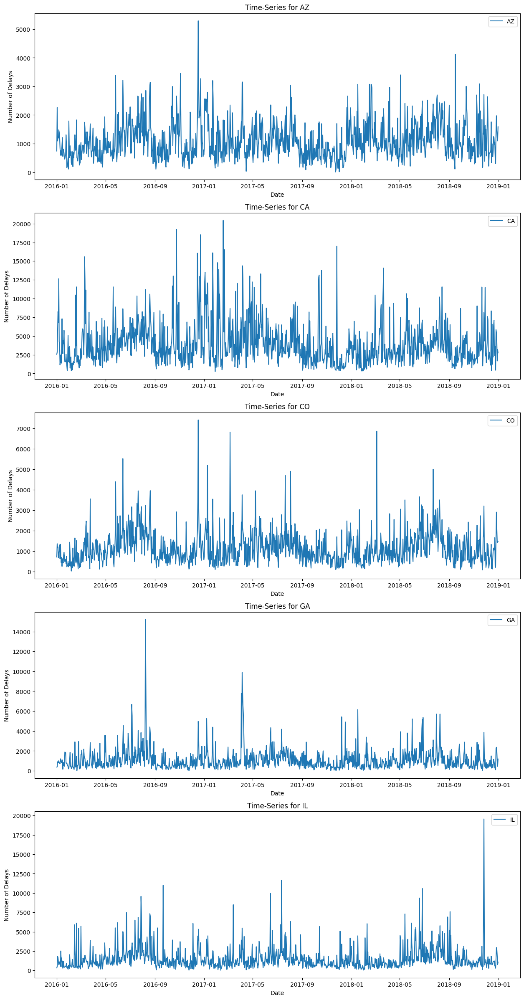

In [20]:
#Step 1

#Import libraries
import pandas as pd
import matplotlib.pyplot as plt

data_raw.columns = pd.to_datetime(data_raw.columns)

def plot_time_series(data_raw, DestState):
    num_DestState = len(DestState)
    plt.figure(figsize=(15, 30))

    for i, state in enumerate(DestState, start=1):
        plt.subplot(num_DestState, 1, i)
        plt.plot(data_raw.columns, data_raw.loc[state])
        plt.title(f'Time-Series for {state}')
        plt.xlabel('Date')
        plt.ylabel('Number of Delays')
        plt.legend([state])

    plt.show()

plot_time_series(data_raw, ['AZ', 'CA', 'CO', 'GA','IL'])


In [21]:
#Step 2

# Import the StandardScaler
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_raw)

# Calculate and print the mean and standard deviation for each day
mean_per_day = data_scaled.mean(axis=0)
std_per_day = data_scaled.std(axis=0)

print("Mean per day after scaling:")
print(mean_per_day)
print("\nStandard deviation per day after scaling:")
print(std_per_day)

# Print the overall mean and standard deviation
print(f"\nOverall mean: {mean_per_day.mean()}")
print(f"Overall standard deviation: {std_per_day.mean()}")



Mean per day after scaling:
[ 9.51619735e-17 -3.96508223e-18  5.55111512e-17 ... -2.85485921e-16
 -7.93016446e-17  1.58603289e-16]

Standard deviation per day after scaling:
[1. 1. 1. ... 1. 1. 1.]

Overall mean: -5.42958263694189e-18
Overall standard deviation: 1.0


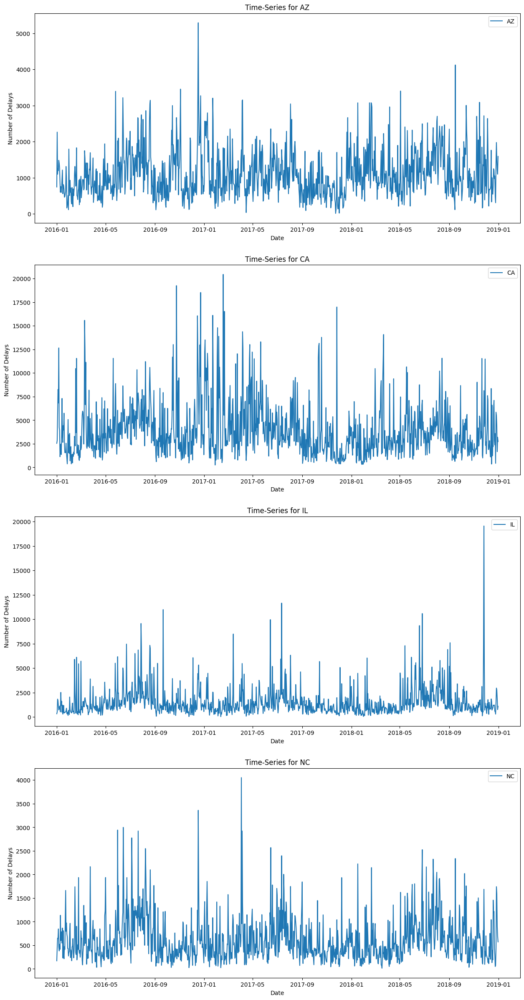

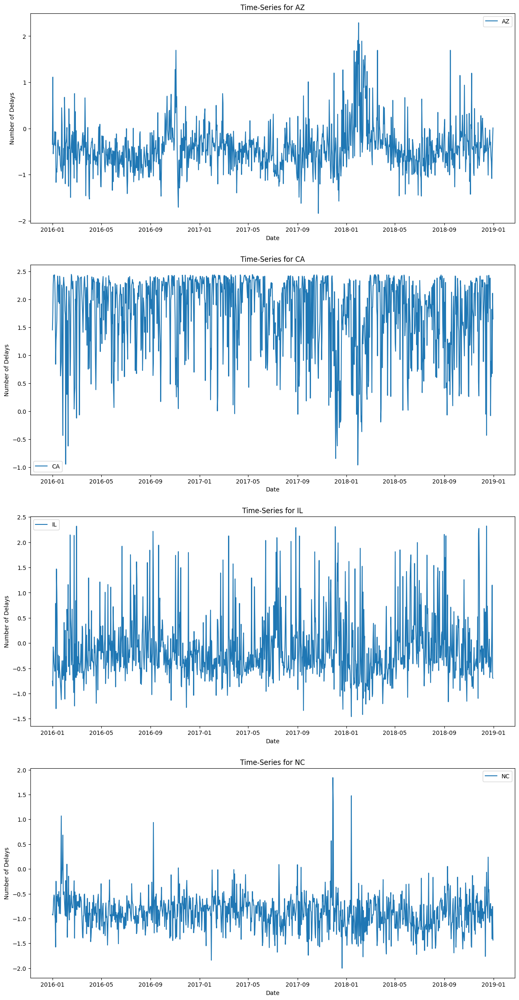

In [22]:
#Step 3

# Run the function on the original dataset
plot_time_series(data_raw, ['AZ', 'CA', 'IL', 'NC'])

#Create new pandas dataset for data_scaled
data_scaled_df = pd.DataFrame(data_scaled, columns=data_raw.columns, index=data_raw.index)
# Run the function on the standardized dataset
plot_time_series(data_scaled_df, ['AZ', 'CA', 'IL', 'NC'])


**Step 4**

**Discuss the trends in the standardized time-series for AZ, CA, IL and NC.**

When examining AZ, we can see that it has lots of variations. There are many periods of were we have an increase and decrease. Also, when looking at late 2017 and early 2018, data peaked during that time which may indicate seasonality such as Christmas/New Year travels. However, the remaining of the data looks normal with ups and downs.
When examining CA, we can see that it too shows the same variations but with obvious ups and downs. Since California has Silicon Valley and other famous cities within it, that may be the reason as to why there we see lots of fluctuations.
When examining IL, we can see that the highs and lows are not consistent. Certain periods exhibit peaks while others show low values. We know that the city of Chicago is located in IL and that it is a financial hub like New York city which may indicate we see lots of fluctuations.
When examining NC, we see that it too has comparable patterns with the other three states.

**What does it mean if the curve goes up or down?**

As the curve goes up, this tells us that the value of that specific point is above the mean value and when the curve goes down, this tells us the value is below the mean.

**What does the sign of values indicate?**

The values from all 4 graphs are significant. When the values are positive, this tells us that the data points are above average mean and when the values are negative, it’s the opposite (i.e., below average mean).


# Part 2: Applying PCA [2 Marks]

1. Compute the covariance matrix of the dataframe. *Hint: The dimensions of your covariance matrix should be ((1095, 1095).* **[0.25]**
2. Write a function `get_sorted_eigen(df_cov)` that gets the covariance matrix of dataframe `df` (from step 1), and returns sorted eigenvalues and eigenvectors using `np.linalg.eigh`. **[0.25]**
3. Show the effectiveness of your principal components in covering the variance of the dataset with a `scree plot`. *Hint: Limit the scree plot to the first 10 PCs . **[0.25]**
4. How many PCs do you need to cover 90% of the dataset's variance? **[0.25]**
5. Plot the first 16 principal components (Eigenvectors) as a time series (16 subplots, on the x-axis you have dates and on the y-axis you have the value of the PC element) . **[0.5]**
6. Compare the first few PCs with the rest of them. Do you see any difference in their trend? **[0.5]**

In [23]:
#Step 1

# Import numpy
import numpy as np

# Compute the covariance matrix
cov_matrix = np.cov(data_scaled_df.T)

# Print the covariance maxtrix dimension
print(f"Covariance matrix dimensions: {cov_matrix.shape}")


Covariance matrix dimensions: (1095, 1095)


In [24]:
#Step 2
def get_sorted_eigen(cov_matrix):
    # Compute the eigenValues and eigenVectors
    eigenValues, eigenVectors = np.linalg.eigh(cov_matrix)

    # Sort the eigenValues and corresponding eigenVectors in descending order
    sorted_indices = np.argsort(eigenValues)[::-1]
    eigenValues = eigenValues[sorted_indices]
    eigenVectors = eigenVectors[:, sorted_indices]

    return eigenValues, eigenVectors

# Get the sorted eigenValues and eigenVectors
eigenValues, eigenVectors = get_sorted_eigen(cov_matrix)
# Prints the first 10 eigenValues
print(f"Sorted eigenValues: {eigenValues[:10]}")


Sorted eigenValues: [8.96325414e+02 1.52314505e+02 8.83966038e+01 6.44660246e+01
 4.27657182e+01 3.32317345e+01 4.30846654e-13 3.76606994e-13
 2.81673127e-13 2.56733159e-13]


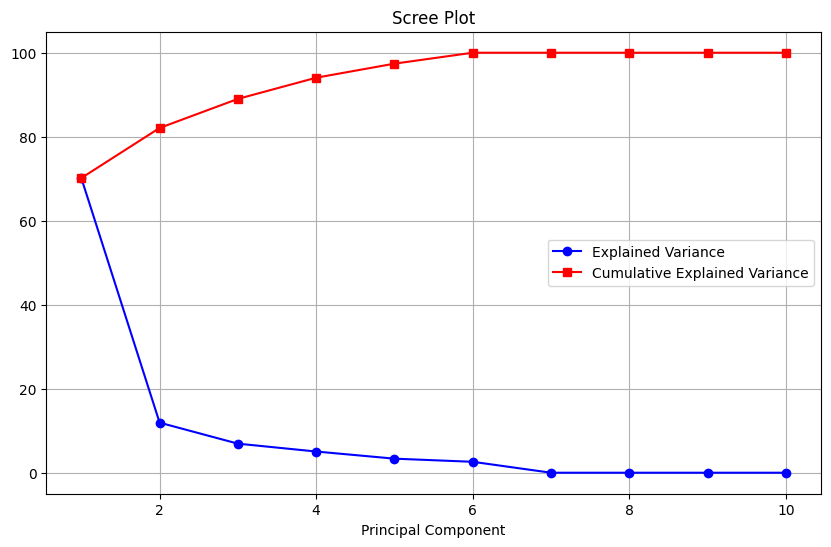

In [25]:
#Step 3
import matplotlib.pyplot as plt

def plot_scree_plot(sorted_eigenValues):
    # Compute the explained variance
    expVar = sorted_eigenValues / np.sum(sorted_eigenValues)*100
    cumExpVar = np.cumsum(expVar)

    # Plot the explained variance
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, 11), expVar[:10], 'o-', color='b', label = 'Explained Variance')
    plt.plot(range(1, 11), cumExpVar[:10], 's-', color='r', label = 'Cumulative Explained Variance')
    plt.title('Scree Plot')
    plt.xlabel('Principal Component')
    plt.grid()
    plt.legend()
    plt.show()

plot_scree_plot(eigenValues)


In [26]:
#Step 4

# Compute the cumulative explained variance
cumulative_expVar = np.cumsum(eigenValues) / np.sum(eigenValues)

# Find the number of components to cover 90% of the variance
num_components_90_var = np.where(cumulative_expVar >= 0.9)[0][0] + 1

# Print the number of components to cover 90% of the variance
print(f"Number of PCs required to cover 90% of the dataset's variance: {num_components_90_var}")


Number of PCs required to cover 90% of the dataset's variance: 4


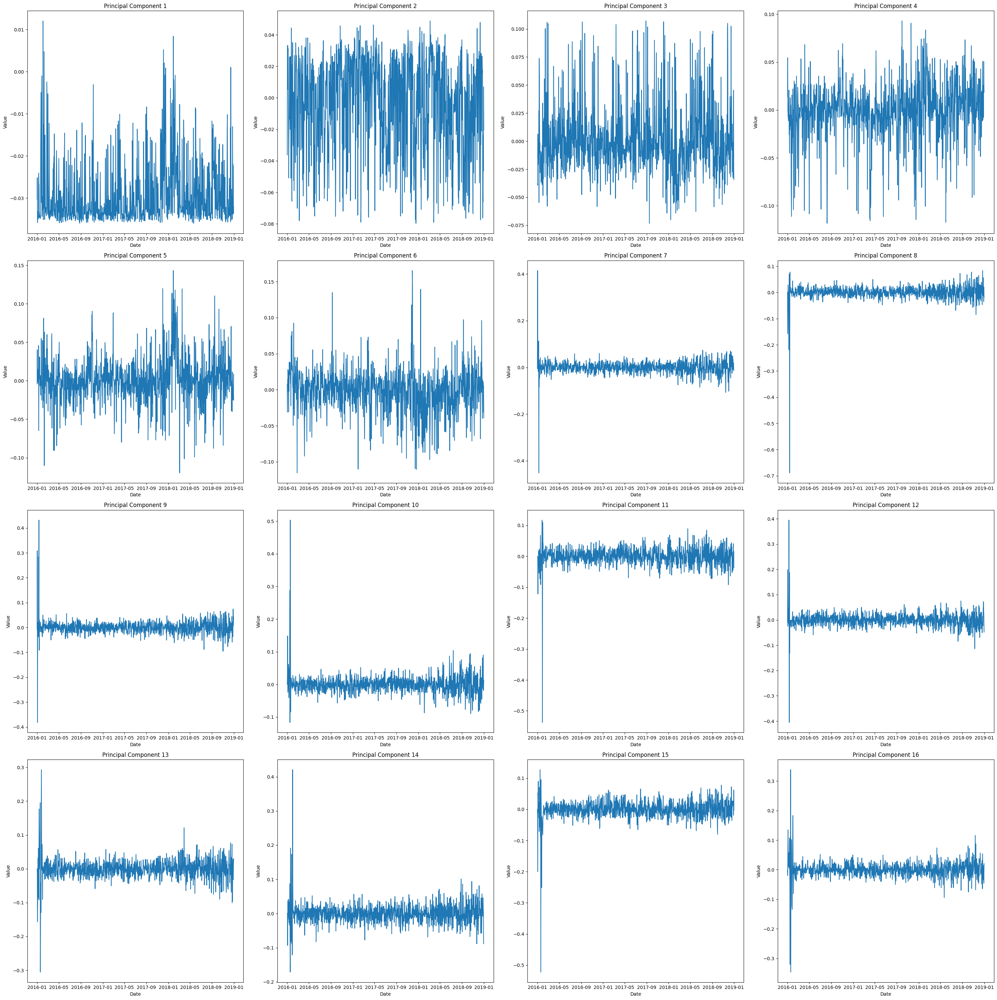

In [27]:
#Step 5
def plot_first_16_pcs(eigenVectors, dates):
    plt.figure(figsize=(30, 30))

    for i in range(16):
        plt.subplot(4, 4, i+1)
        plt.plot(dates, eigenVectors[:, i])
        plt.title(f'Principal Component {i+1}')
        plt.xlabel('Date')
        plt.ylabel('Value')

    plt.tight_layout()
    plt.show()

# Convert the column names back to dates for plotting
dates = data_scaled_df.columns

plot_first_16_pcs(eigenVectors, dates)


**Compare the first few PCs with the rest of them. Do you see any difference in their trend?**

Yes, I do see differences in their trend. The first PC shows huge fluctuations which points to it capturing most of the variance of the data. The second, third, and fourth all exhibt large differences in variability. From the fifth PC and onwards, we can see that less and less varaiability is captured. This means they do not capture important trends but finer details.

# Part 3: Data reconstruction [4.5 Marks]

Create a function that:

*   Accepts a destination state and the original dataset as inputs.
*   Calls useful functions that you designed in previous parts to compute eigenvectors and eigenvalues.
*   Plots 4 figures:
  1.   The original time-series for the specified state. **[0.5]**
  2.   The incremental reconstruction of the **original** (not standardized) time-series for the specified state in a single plot. **[1.5]**
       * You should show 4 curves in a figure for incremental reconstruction by picking the following combinations:
          * Reconstruction with only PC1
          * Reconstruction with both PC1 and PC2
          * Reconstruction with PC1 to PC4 (First 4 PCs)
          * Reconstruction with PC1 to PC6 (First 6 PCs)

      * Hint: you need to compute the reconstruction for the standardized time-series first, and then scale it back to the original (non-standardized form) using the StandardScaler `inverse_transform` [help...](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html#sklearn.preprocessing.StandardScaler.inverse_transform)
  3.   The residual error for your best reconstruction with respect to the original time-series. **[1]**
      * Hint: You are plotting the error that we have for reconstructing each day `(df - df_reconstructed)`. On the x-axis, you have dates, and on the y-axis, the residual error.
  4.   The RMSE of the reconstruction as a function of the number of included components (x-axis is the number of components and y-axis is the RMSE). Sweep x-axis from 1 to 7 (this part is independent from part 3.2.) **[1]**

Test your function using the `AZ`, `CA`, `IL` and `NC` as inputs. **[0.5]**


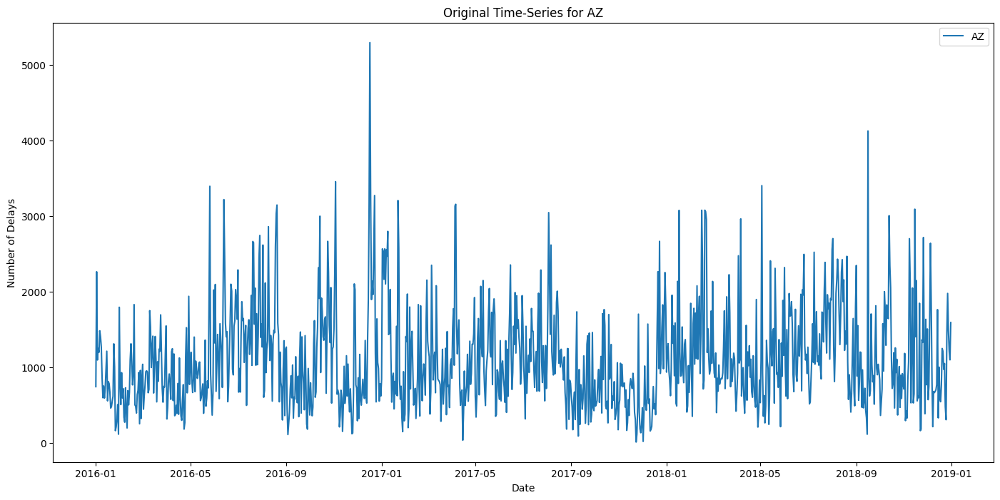

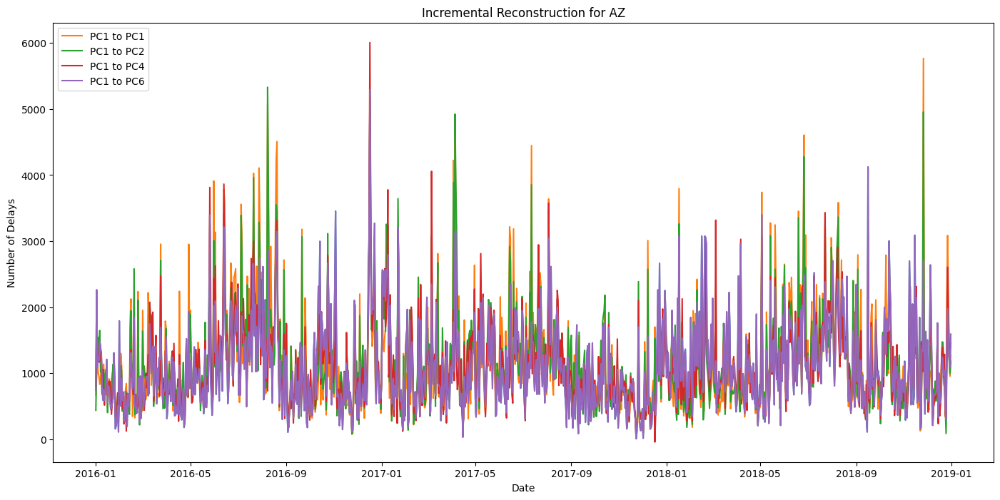

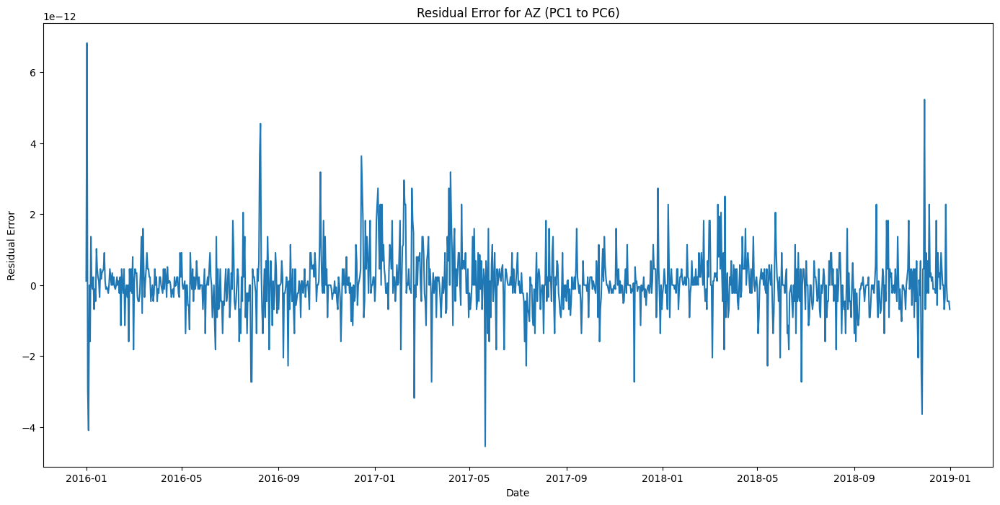

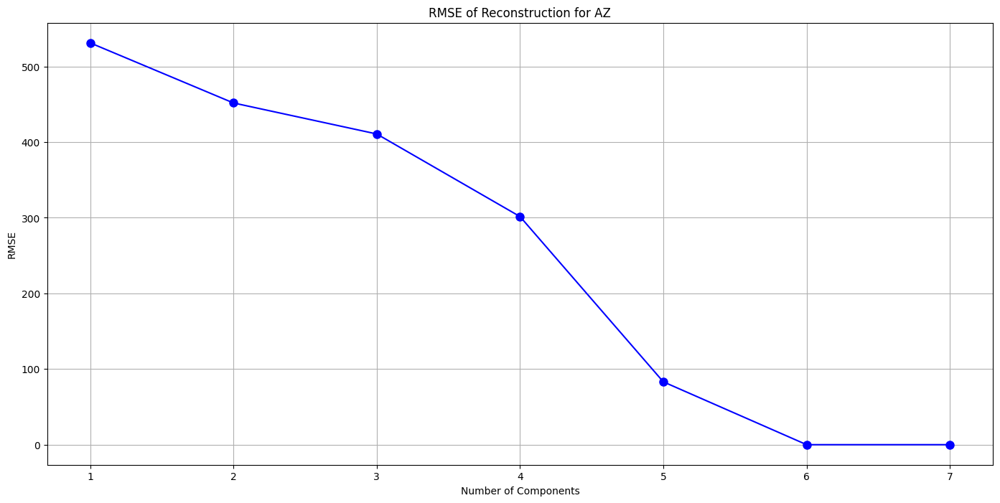

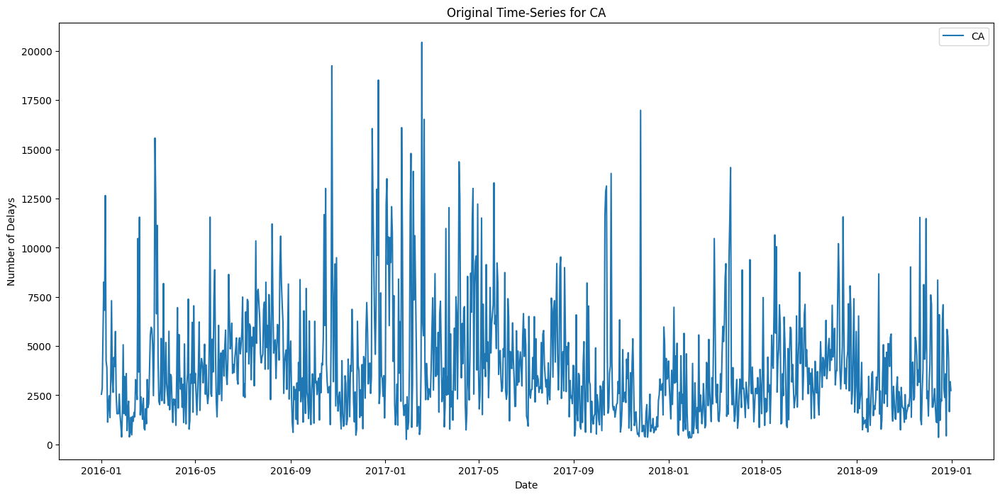

...

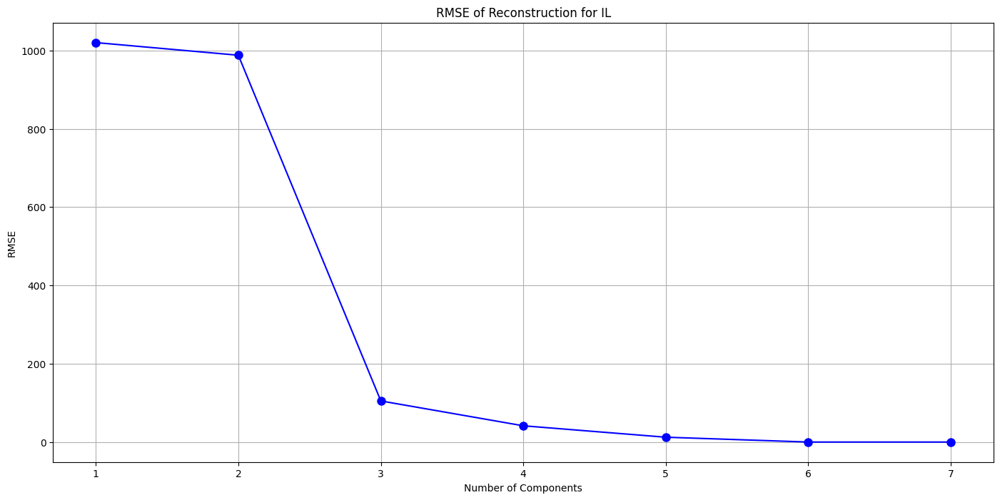

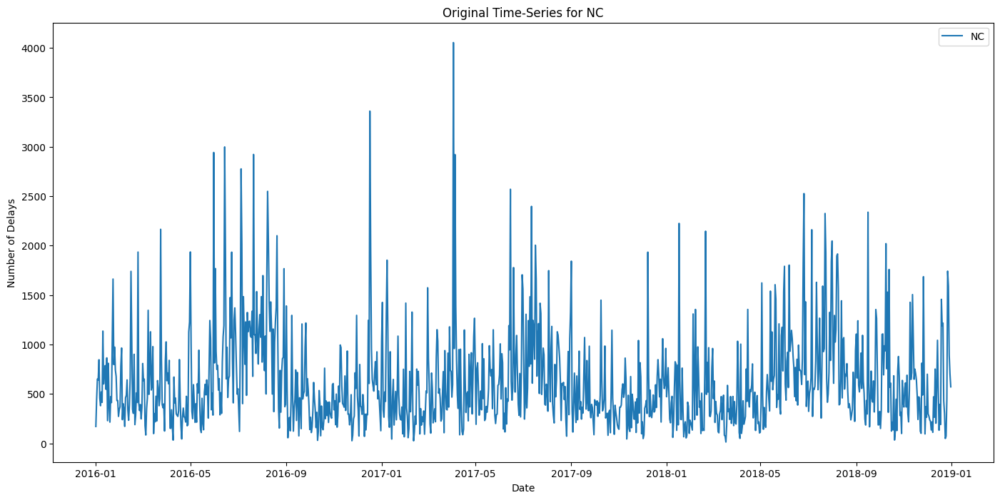

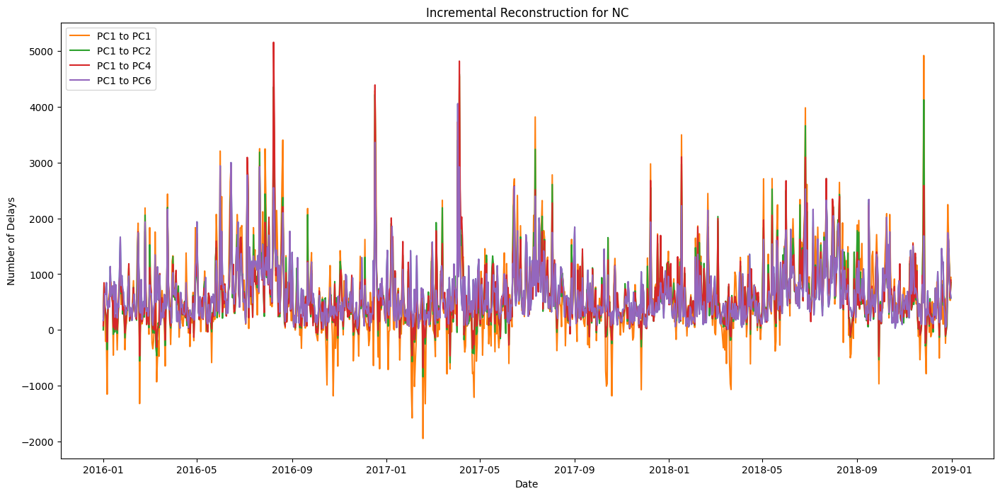

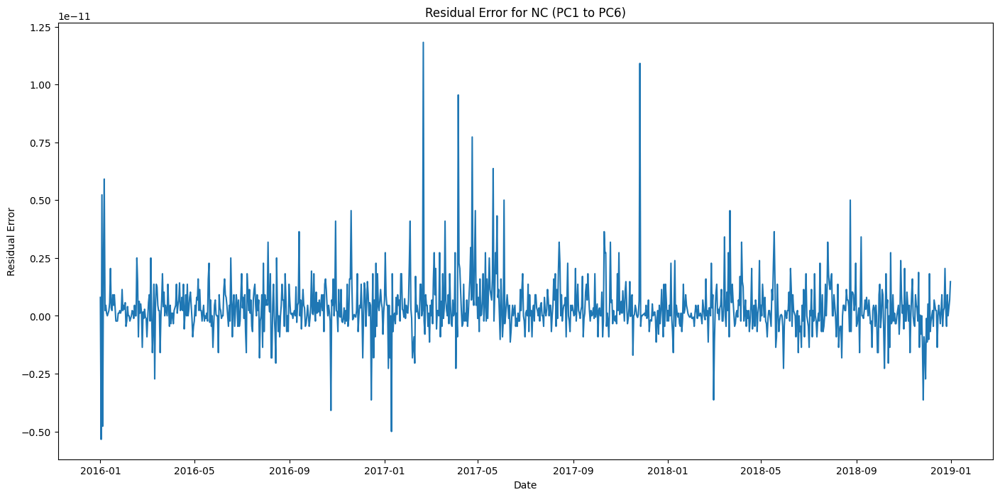

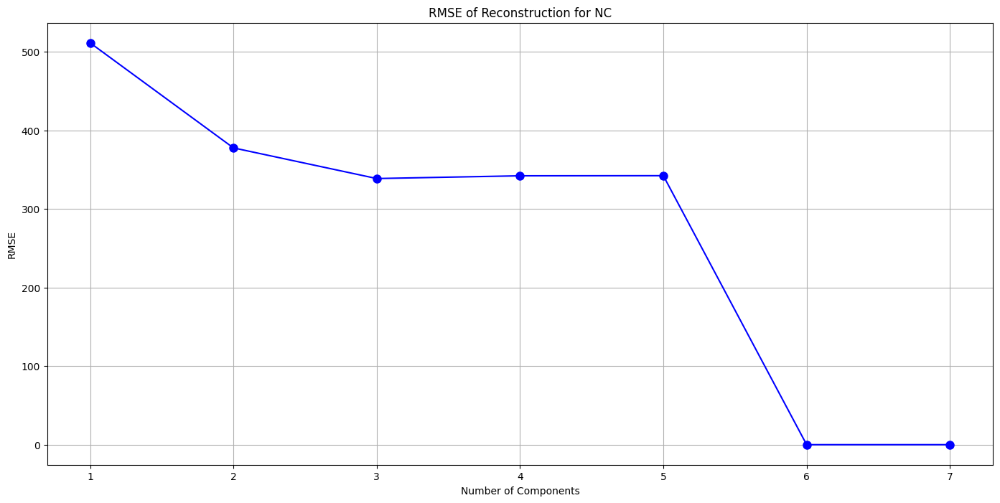

In [28]:

# Step 1: Compute the Covariance Matrix
def compute_covariance_matrix(data):
    return np.cov(data.T)

# Step 2: This function performs the incremental reconstruction and plots the required figures
def plot_reconstruction(state, data_raw):
    scaler = StandardScaler()
    data_scaled = scaler.fit_transform(data_raw)
    cov_matrix = compute_covariance_matrix(data_scaled)
    eigenValues, eigenVectors = get_sorted_eigen(cov_matrix)
    expVar = eigenValues / np.sum(eigenValues)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend([state])
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6]
    reconstructions = {}
    for number_of_pcs in pcs_list:
        eigenVectors_subset = eigenVectors[:, :number_of_pcs]
        scores = np.dot(data_scaled, eigenVectors_subset)
        reconstruction_scaled = np.dot(scores, eigenVectors_subset.T)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        reconstructions[number_of_pcs] = reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    for number_of_pcs_1 in pcs_list:
        plt.plot(data_raw.columns, reconstructions[number_of_pcs_1][data_raw.index.get_loc(state)], label=f'PC1 to PC{number_of_pcs_1}')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    best_reconstruction = reconstructions[6]
    residual_error = data_raw.loc[state] - best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, residual_error)
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    rmse = []
    for number_of_pcs_2 in range(1, 8):
        eigenVectors_subset = eigenVectors[:, :number_of_pcs_2]
        scores = np.dot(data_scaled, eigenVectors_subset)
        reconstruction_scaled = np.dot(scores, eigenVectors_subset.T)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        rmse.append(rmse_1)

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 8), rmse, 'o-', markersize=8, color='b')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.grid()
    plt.show()

# Test the function using AZ, CA, IL, and NC as inputs
for state in ['AZ', 'CA', 'IL', 'NC']:
    plot_reconstruction(state, data_raw)


# Part 4: SVD [2 Marks]
Modify your code in part 3 to use SVD instead of PCA. **[1]**

Explain if standardization or covariance computation is required for this part.
Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison **[0.5]**, and comment on the results. **[0.5]**.

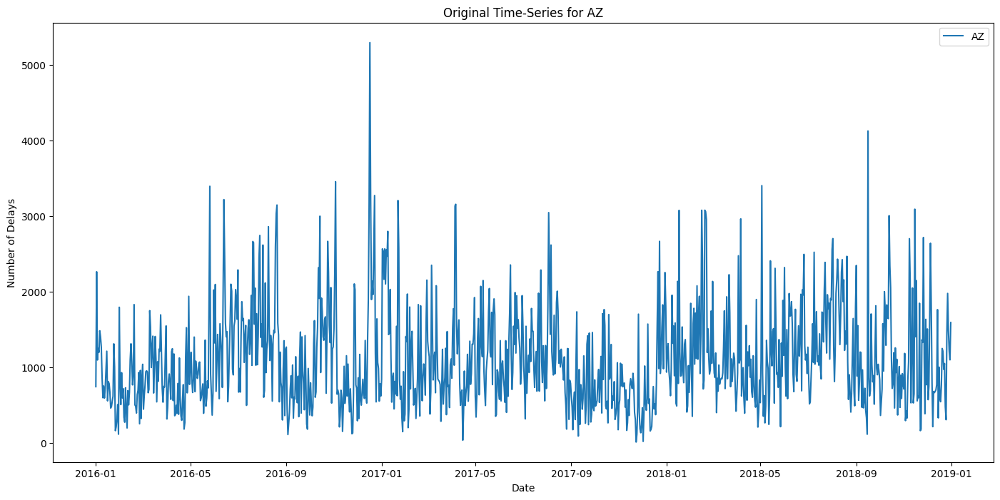

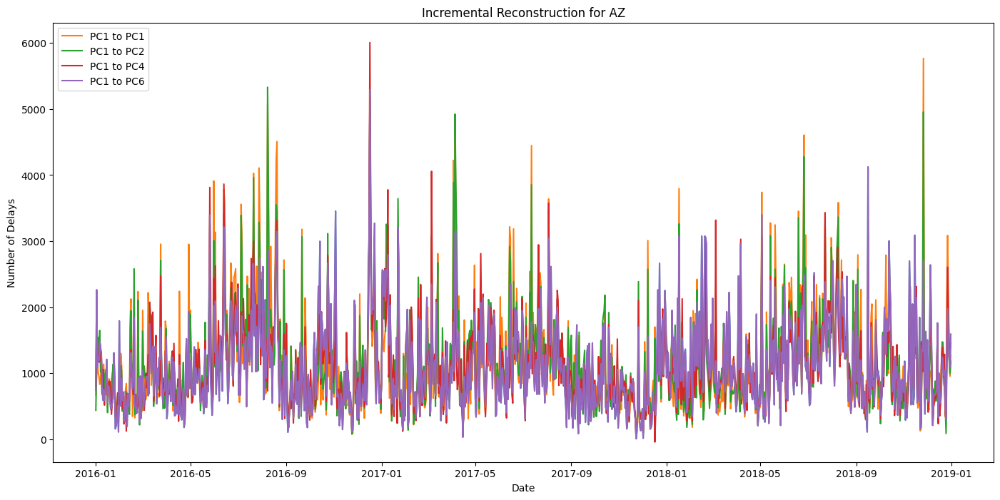

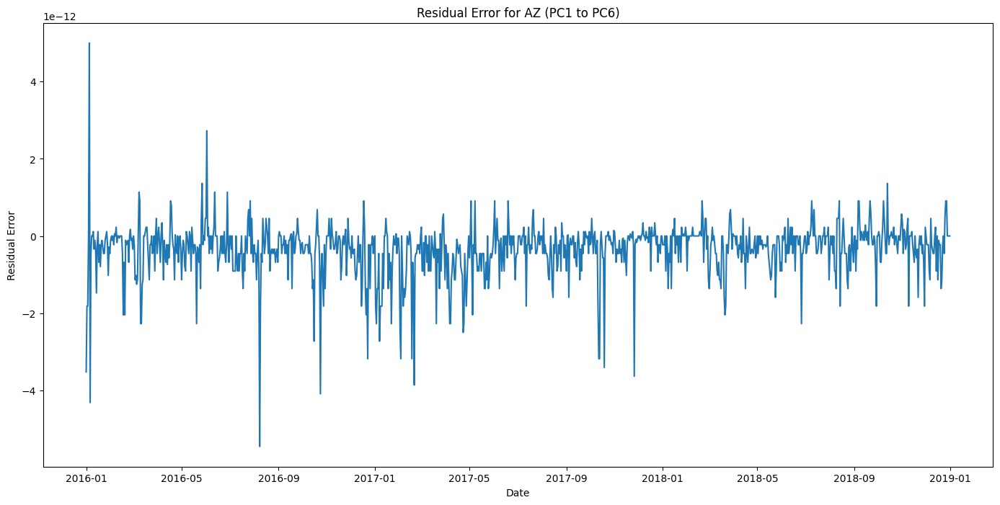

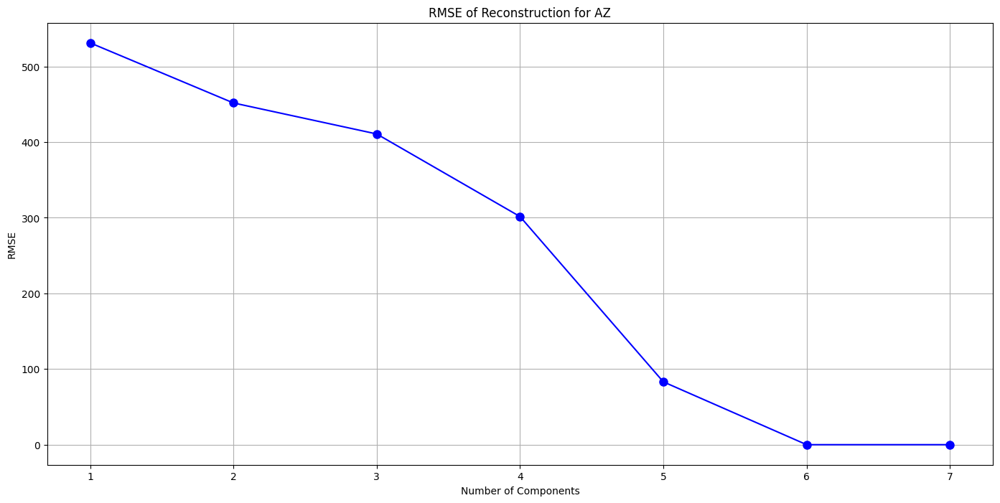

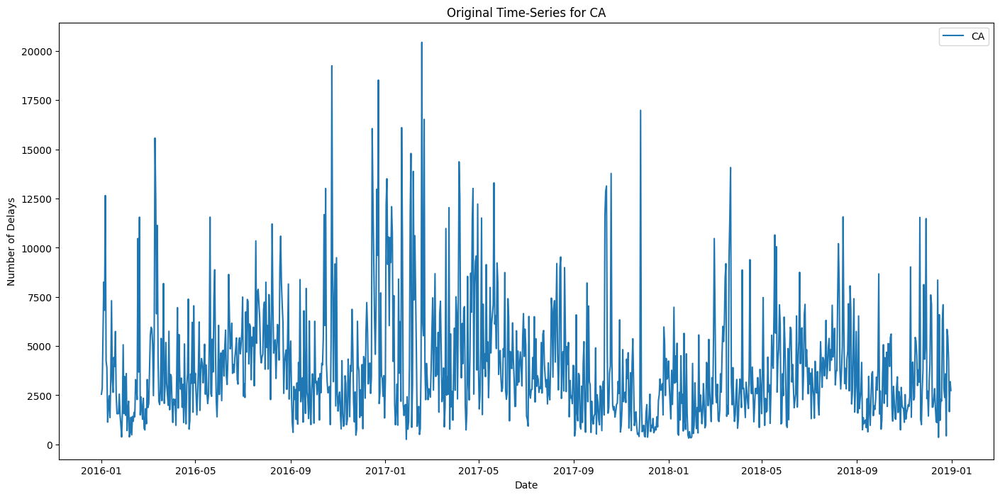

...

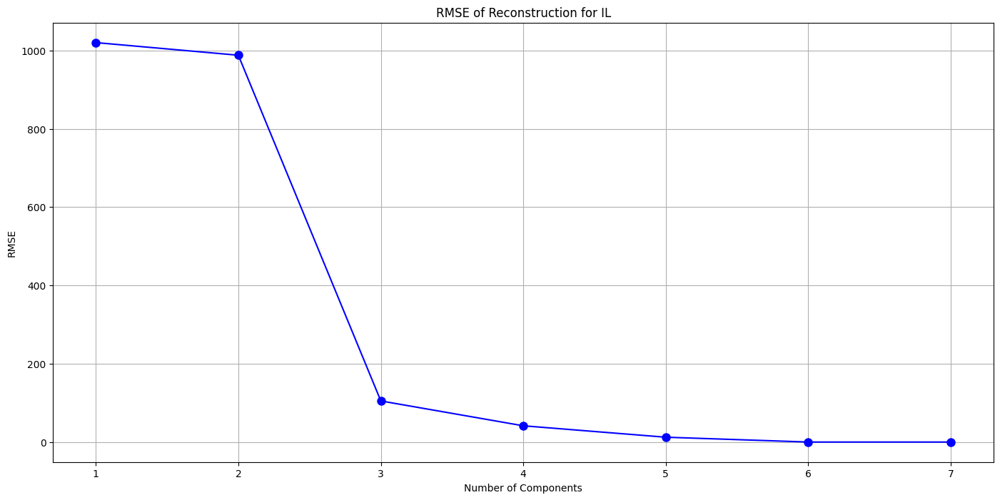

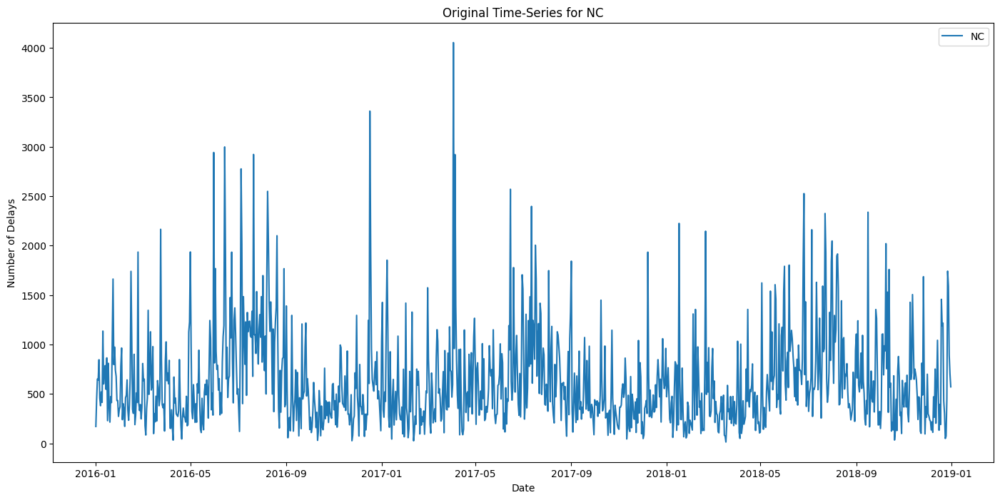

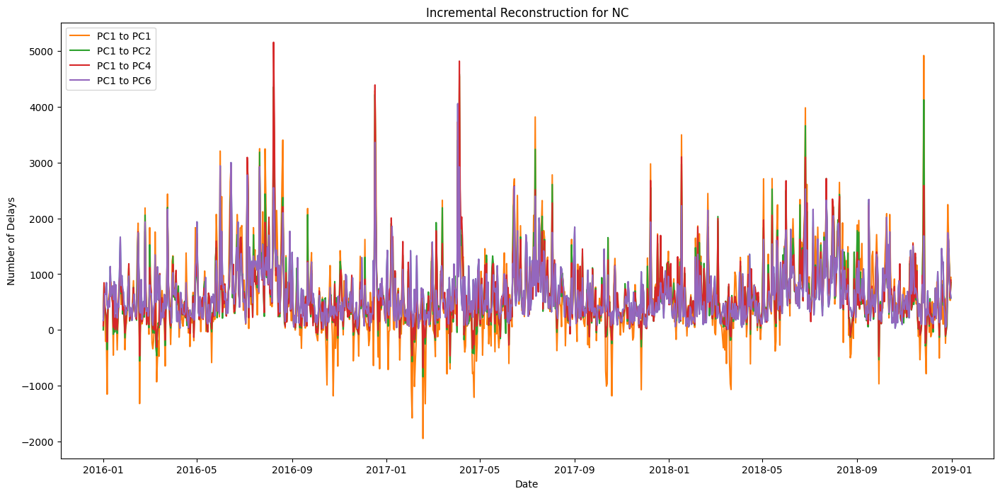

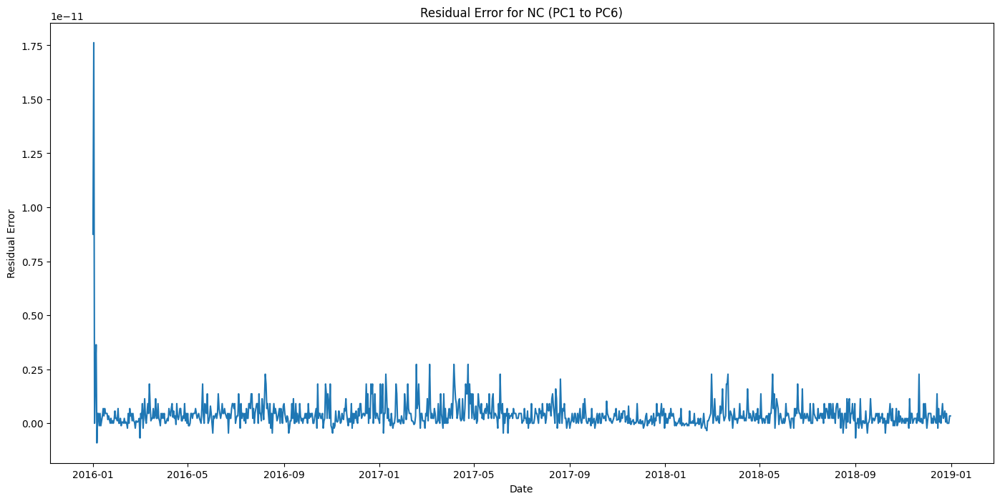

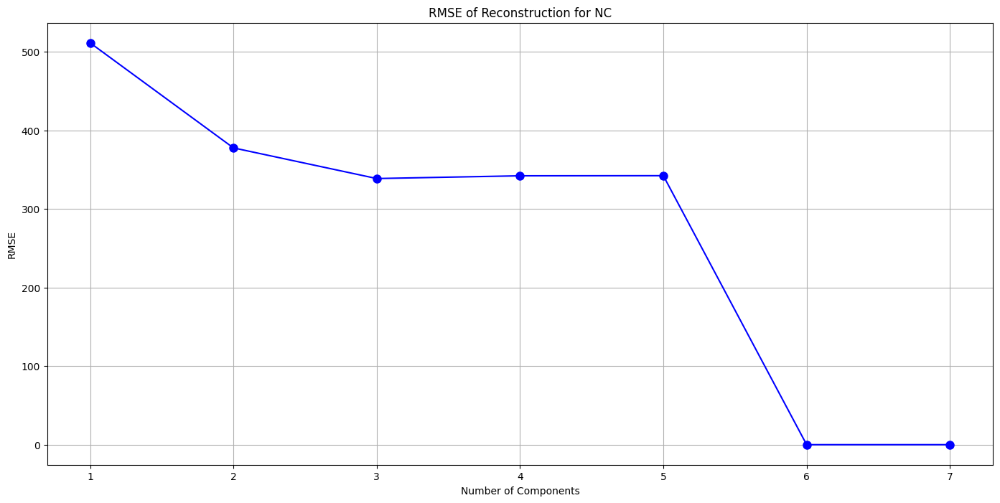

In [29]:

# Step 1: Perform SVD
def compute_svd(data):
    U, S, VT = np.linalg.svd(data, full_matrices=False)
    return U, S, VT

# Step 2: This function performs the incremental reconstruction and plots the required figures using SVD
def plot_reconstruction(state, data_raw):
    scaler = StandardScaler()
    data_scaled = scaler.fit_transform(data_raw)

    U, S, VT = compute_svd(data_scaled)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend([state])
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6]
    reconstructions = {}
    for number_of_pcs in pcs_list:
        scores = np.dot(U[:, :number_of_pcs], np.diag(S[:number_of_pcs]))
        reconstruction_scaled = np.dot(scores, VT[:number_of_pcs, :])
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        reconstructions[number_of_pcs] = reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    for number_of_pcs_1 in pcs_list:
        plt.plot(data_raw.columns, reconstructions[number_of_pcs_1][data_raw.index.get_loc(state)], label=f'PC1 to PC{number_of_pcs_1}')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    best_reconstruction = reconstructions[6]
    residual_error = data_raw.loc[state] - best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, residual_error)
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    rmse = []
    for number_of_pcs_2 in range(1, 8):
        scores = np.dot(U[:, :number_of_pcs_2], np.diag(S[:number_of_pcs_2]))
        reconstruction_scaled = np.dot(scores, VT[:number_of_pcs_2, :])
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        rmse.append(rmse_1)

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 8), rmse, 'o-', markersize=8, color='b')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.grid()
    plt.show()

# Test the function using AZ, CA, IL, and NC as inputs
for state in ['AZ', 'CA', 'IL', 'NC']:
    plot_reconstruction(state, data_raw)


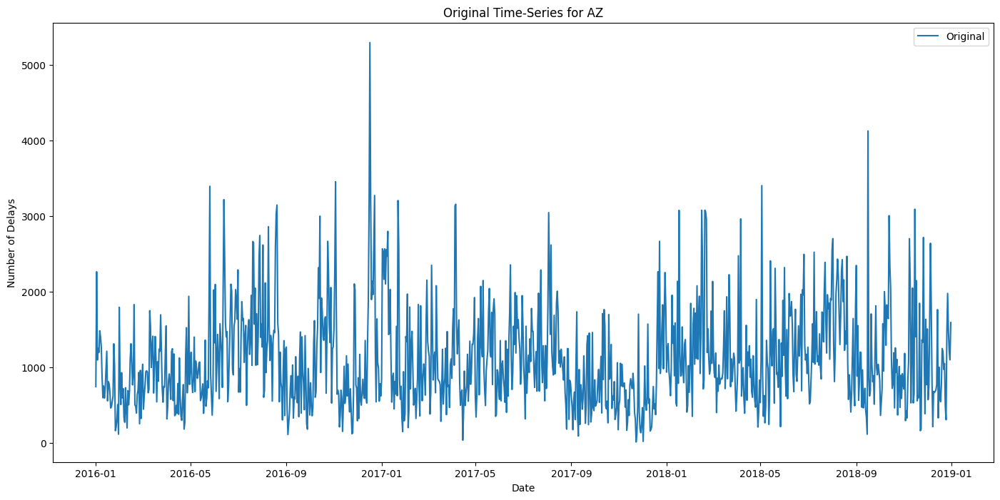

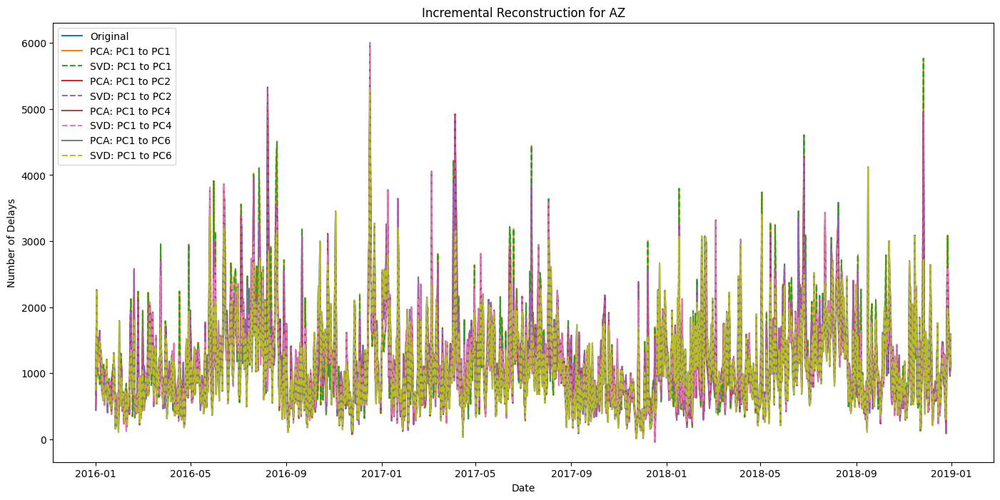

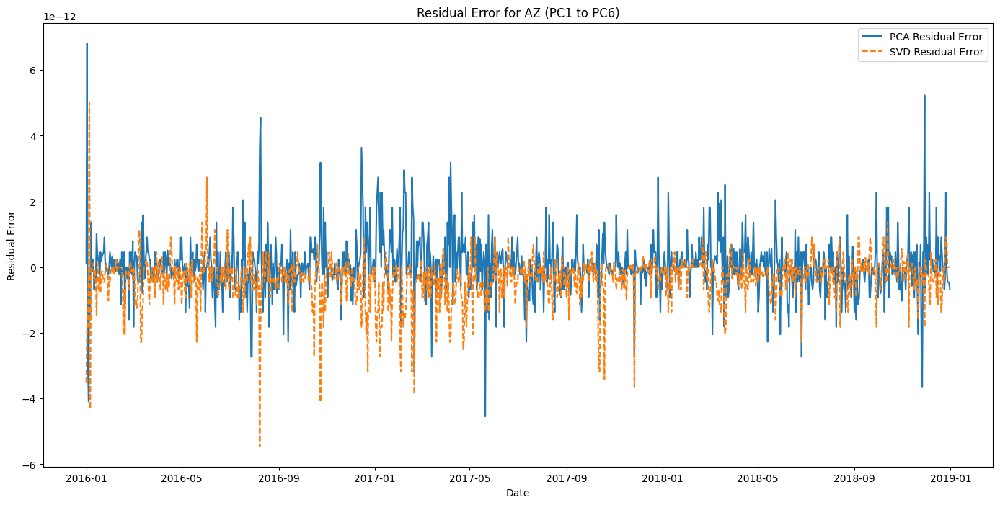

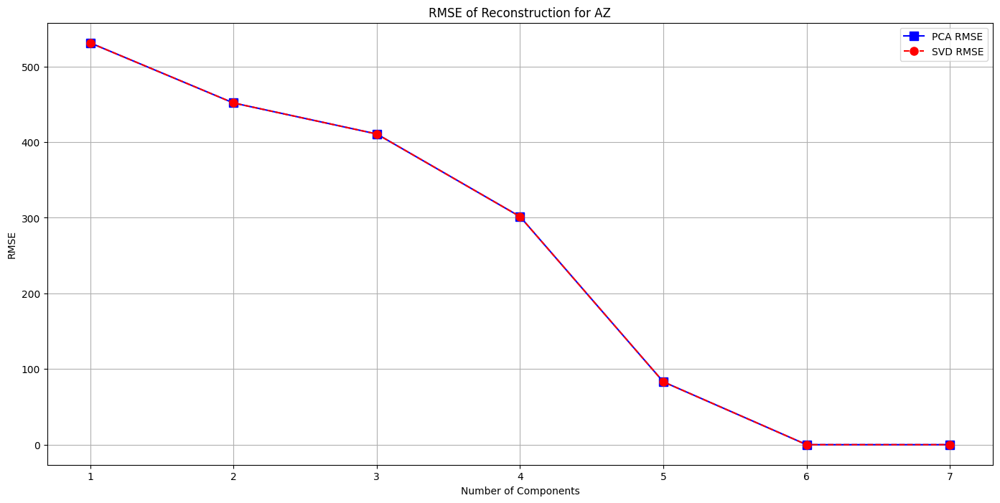

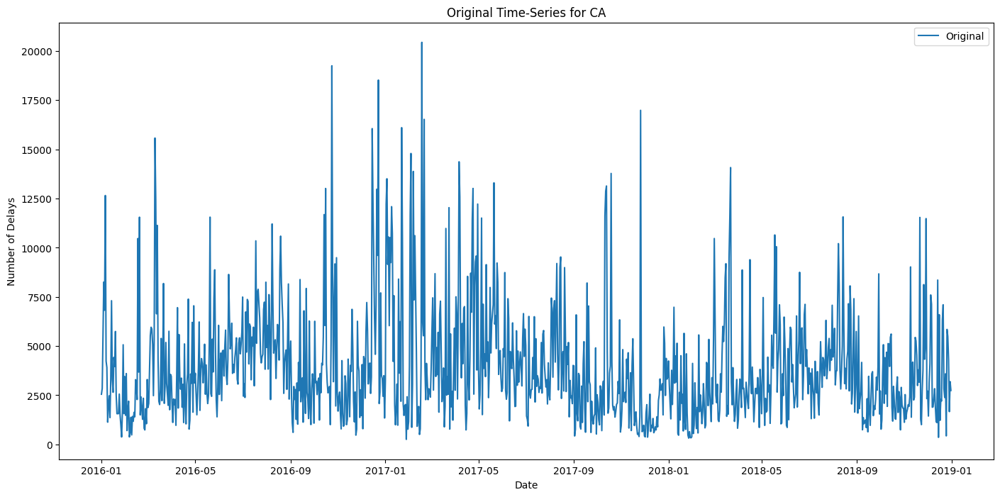

...

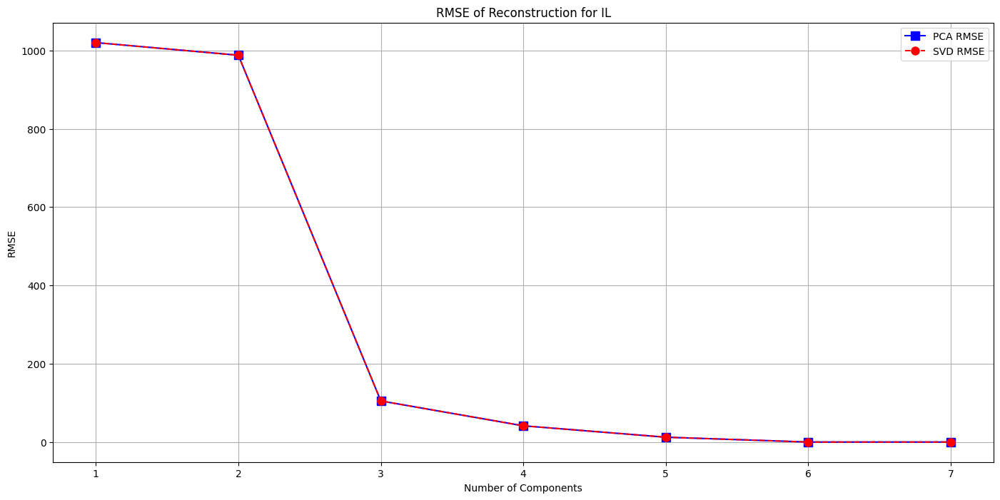

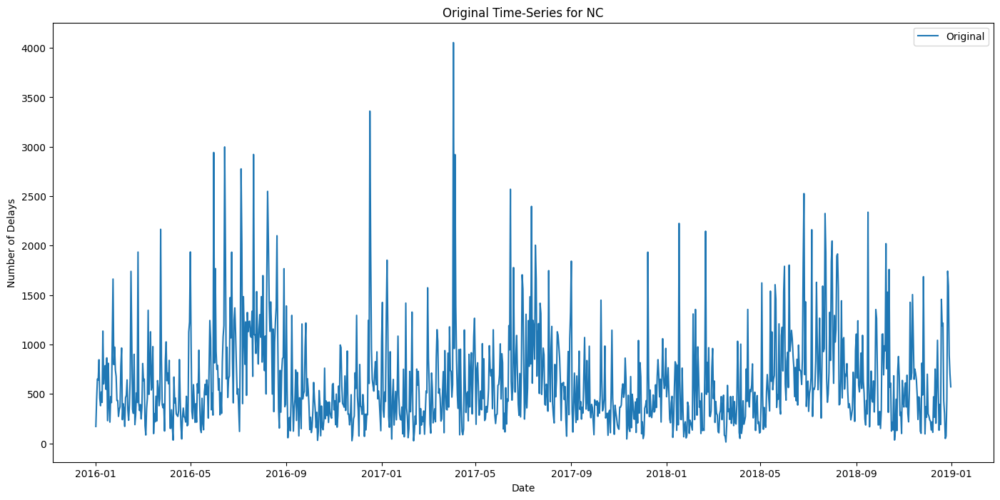

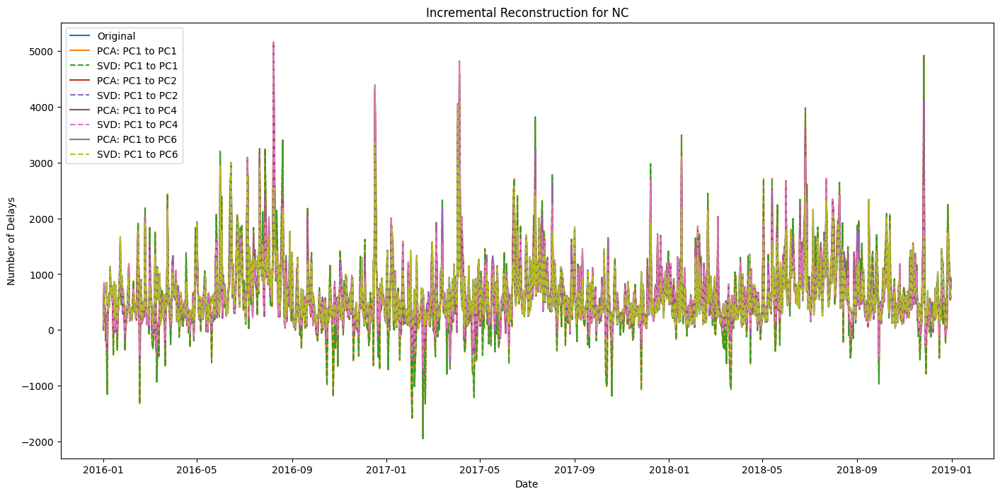

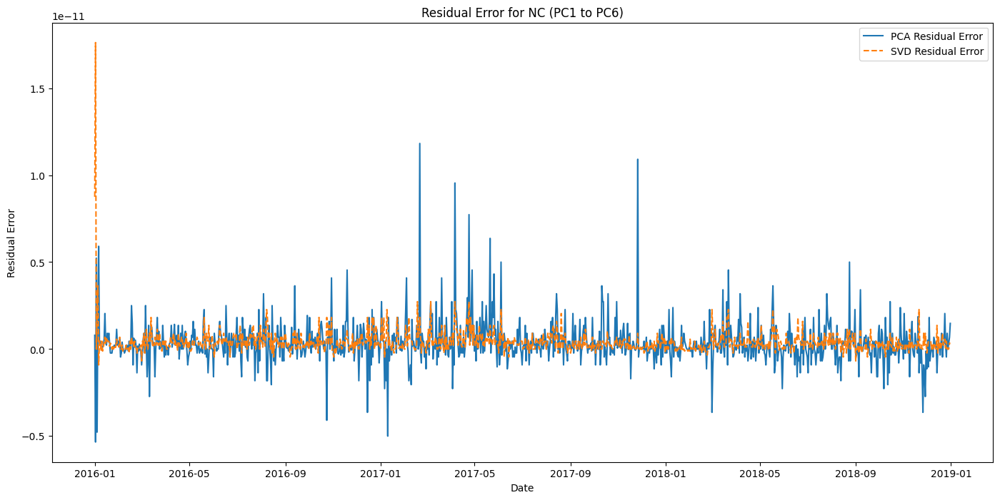

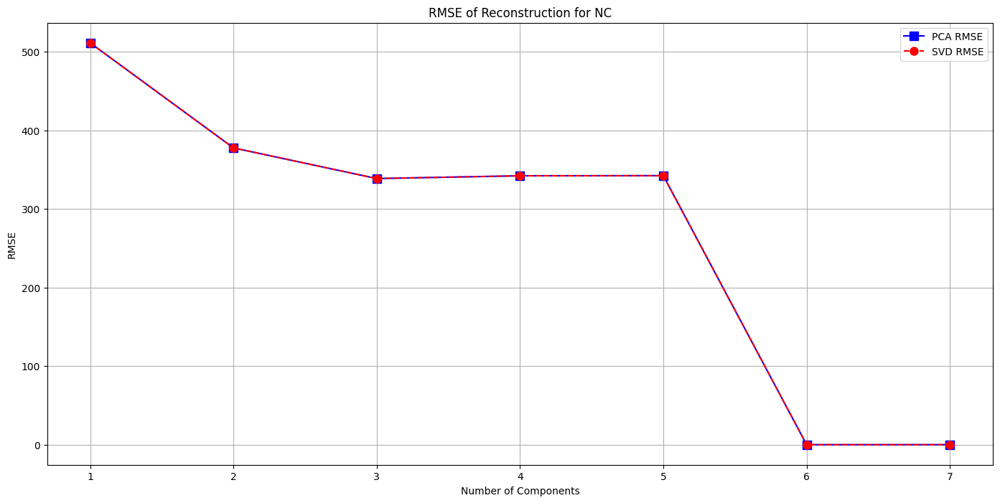

In [30]:
# Comparison between PCA and SVD

# Function to plot the reconstruction and compare PCA and SVD
def compare_pca_svd(state, data_raw):
    scaler = StandardScaler()
    data_scaled = scaler.fit_transform(data_raw)

    # PCA
    cov_matrix = compute_covariance_matrix(data_scaled)
    pca_eigenValues, pca_eigenVectors = get_sorted_eigen(cov_matrix)
    pca_expVar = pca_eigenValues / np.sum(pca_eigenValues)

    # SVD
    U, S, VT = compute_svd(data_scaled)
    svd_expVar = (S ** 2) / np.sum(S ** 2)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state], label='Original')
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6]
    pca_reconstructions = {}
    svd_reconstructions = {}

    for number_of_pcs in pcs_list:
        # PCA reconstruction
        pca_eigenVectors_subset = pca_eigenVectors[:, :number_of_pcs]
        pca_scores = np.dot(data_scaled, pca_eigenVectors_subset)
        pca_reconstruction_scaled = np.dot(pca_scores, pca_eigenVectors_subset.T)
        pca_reconstruction_original = scaler.inverse_transform(pca_reconstruction_scaled)
        pca_reconstructions[number_of_pcs] = pca_reconstruction_original

        # SVD reconstruction
        svd_scores = np.dot(U[:, :number_of_pcs], np.diag(S[:number_of_pcs]))
        svd_reconstruction_scaled = np.dot(svd_scores, VT[:number_of_pcs, :])
        svd_reconstruction_original = scaler.inverse_transform(svd_reconstruction_scaled)
        svd_reconstructions[number_of_pcs] = svd_reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state], label='Original')
    for number_of_pcs in pcs_list:
        plt.plot(data_raw.columns, pca_reconstructions[number_of_pcs][data_raw.index.get_loc(state)],
                 label=f'PCA: PC1 to PC{number_of_pcs}')
        plt.plot(data_raw.columns, svd_reconstructions[number_of_pcs][data_raw.index.get_loc(state)],
                 label=f'SVD: PC1 to PC{number_of_pcs}', linestyle='dashed')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    pca_best_reconstruction = pca_reconstructions[6]
    svd_best_reconstruction = svd_reconstructions[6]
    pca_residual_error = data_raw.loc[state] - pca_best_reconstruction[data_raw.index.get_loc(state)]
    svd_residual_error = data_raw.loc[state] - svd_best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, pca_residual_error, label='PCA Residual Error')
    plt.plot(data_raw.columns, svd_residual_error, label='SVD Residual Error', linestyle='dashed')
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.legend()
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    pca_rmse = []
    svd_rmse = []

    for number_of_pcs in range(1, 8):
        # PCA RMSE
        pca_eigenVectors_subset = pca_eigenVectors[:, :number_of_pcs]
        pca_scores = np.dot(data_scaled, pca_eigenVectors_subset)
        pca_reconstruction_scaled = np.dot(pca_scores, pca_eigenVectors_subset.T)
        pca_reconstruction_original = scaler.inverse_transform(pca_reconstruction_scaled)
        pca_rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - pca_reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        pca_rmse.append(pca_rmse_1)

        # SVD RMSE
        svd_scores = np.dot(U[:, :number_of_pcs], np.diag(S[:number_of_pcs]))
        svd_reconstruction_scaled = np.dot(svd_scores, VT[:number_of_pcs, :])
        svd_reconstruction_original = scaler.inverse_transform(svd_reconstruction_scaled)
        svd_rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - svd_reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        svd_rmse.append(svd_rmse_1)

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 8), pca_rmse, 's-', markersize=8, color='b', label='PCA RMSE')
    plt.plot(range(1, 8), svd_rmse, 'o--', markersize=8, color='r', label='SVD RMSE')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.legend()
    plt.grid()
    plt.show()

# Test the function using AZ, CA, IL, and NC as inputs
for state in ['AZ', 'CA', 'IL', 'NC']:
    compare_pca_svd(state, data_raw)


Explain if standardization or covariance computation is required for this part.
Repeat part 3 and compare your PCA and SVD results. Write a function to make this comparison, and comment on the results.

Standardization is required for this part and not covariance computation as covariance computation does not deal with the issue of featues having different scales. This means had I not chosen standardization, the variances and covariances of the covariance matrix will be overshadowed by features that have larger dimensions. Additionally, standardization is used in principal component analysis and singular value decomposition as it will help in avoiding numerical issues, have all the featureas contribute equally, and display which principal components maximixe variance. When comparing the RMSE for the affected states when using PCA nad SVD, we can see that they are exactly the same. However, the residual error and incremental reconstruction were different.  


# Part 5: Let's collect another dataset! [2.5 Marks]
Create another dataset similar to the one provided in your handout using the raw information on average flight delays for different cities of origin in the United States from 2017 to 2018 [here](https://github.com/Sabaae/Dataset/blob/main/AverageDelaysbyOrigin.csv). **[1]**


You need to manipulate the data to organize it in the desired format (i.e., the same format as the dataset in part 1).

You are free to use any tools you like, from Excel to Python! In the end, you should have a new CSV file similar to the previous dataset. How many features does the final dataset have? How many cities (ORIGIN airport codes) are there?


Upload your new dataset (in CSV format) to your colab notebook and repeat part 4 for this dataset **[1]**. For the incremental reconstruction section (part 3.2), this time consider the following combinations:
  * Reconstruction with only PC1
  * Reconstruction with both PC1 and PC2
  * Reconstruction with PC1 to PC4 (First 4 PCs)
  * Reconstruction with PC1 to PC6 (First 6 PCs)
  * Reconstruction with PC1 to PC8 (First 8 PCs)


Also for the reconstruction RMSE function (part 3.4), this time sweep the number of components (x-axis) from 1 to 8.


Comment on the results **[0.5]**. When analyzing the cities (airport codes), you may use`ATL`, `CLT`, `DFW`, `LAX`, and `PHX`.


The code below helps you to upload your new CSV file to your colab session.

In [31]:
# load train.csv to Google Colab
# from google.colab import files
# uploaded = files.upload()

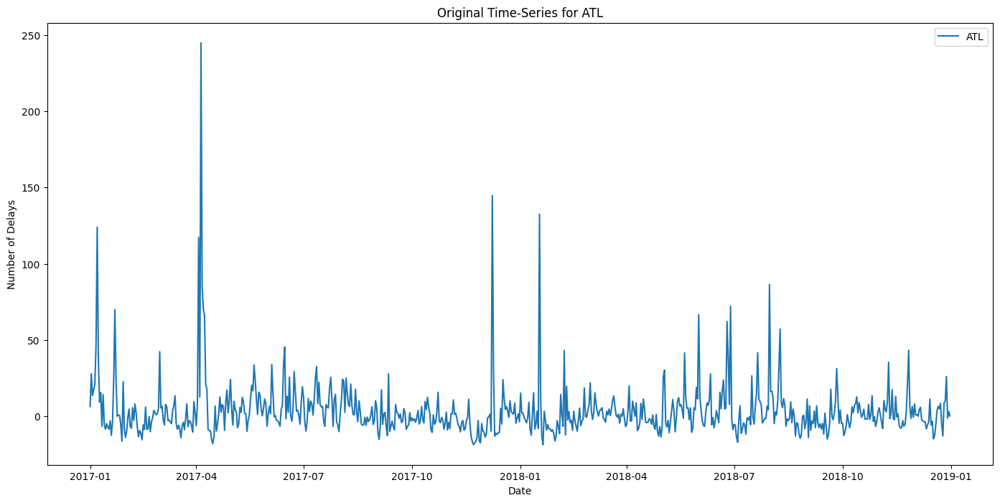

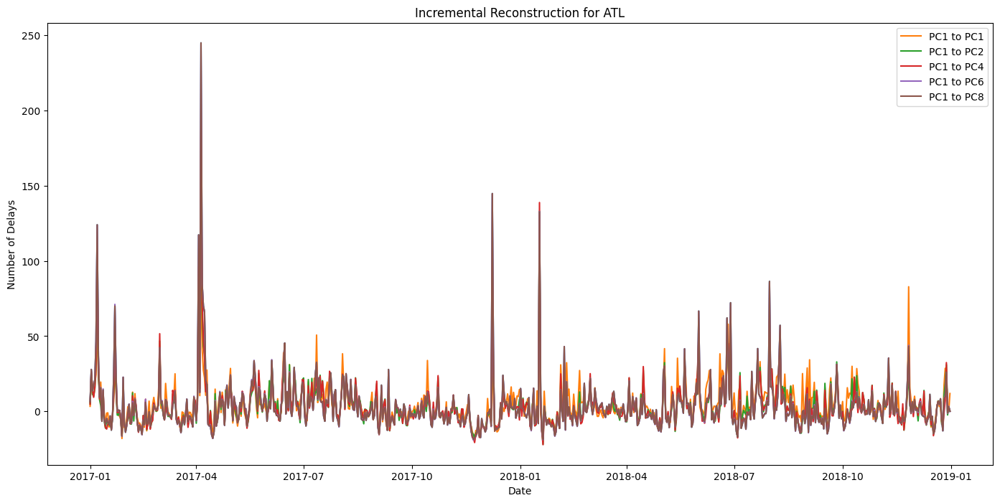

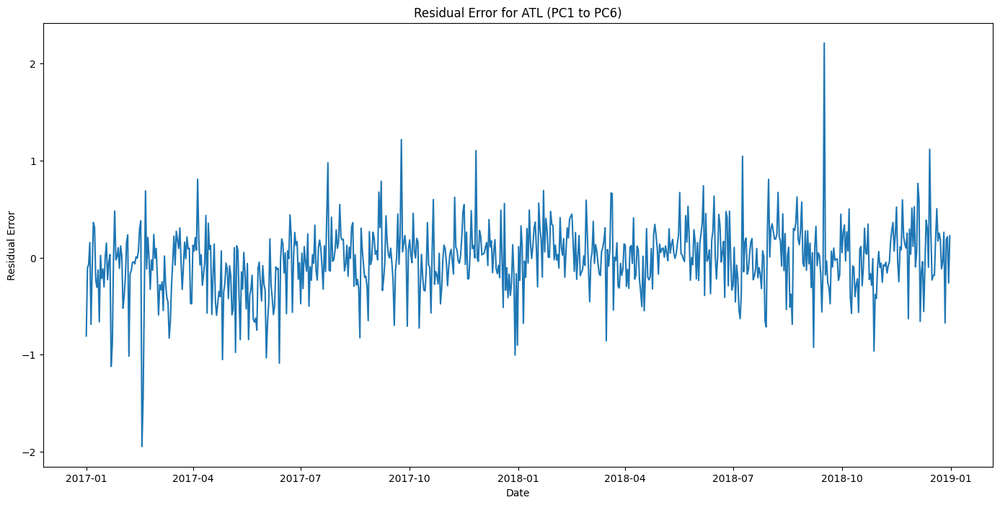

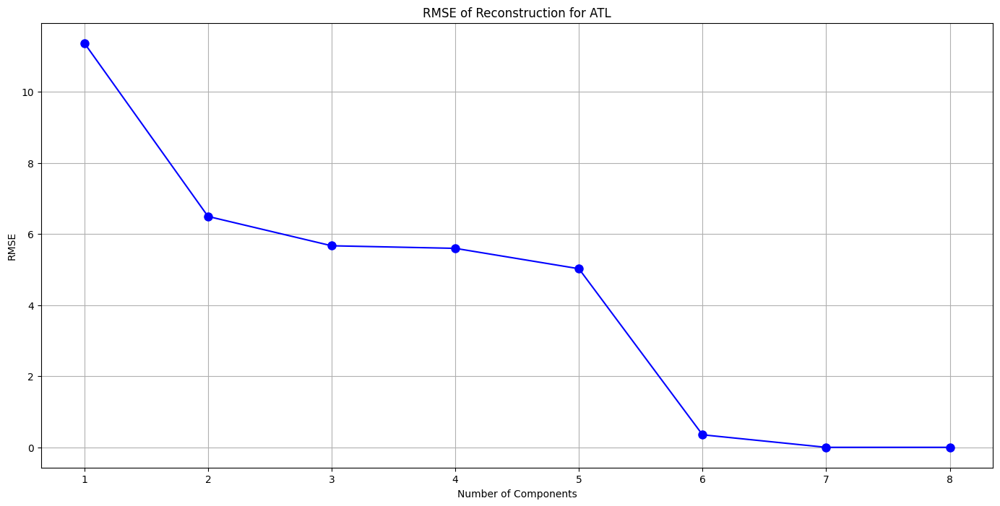

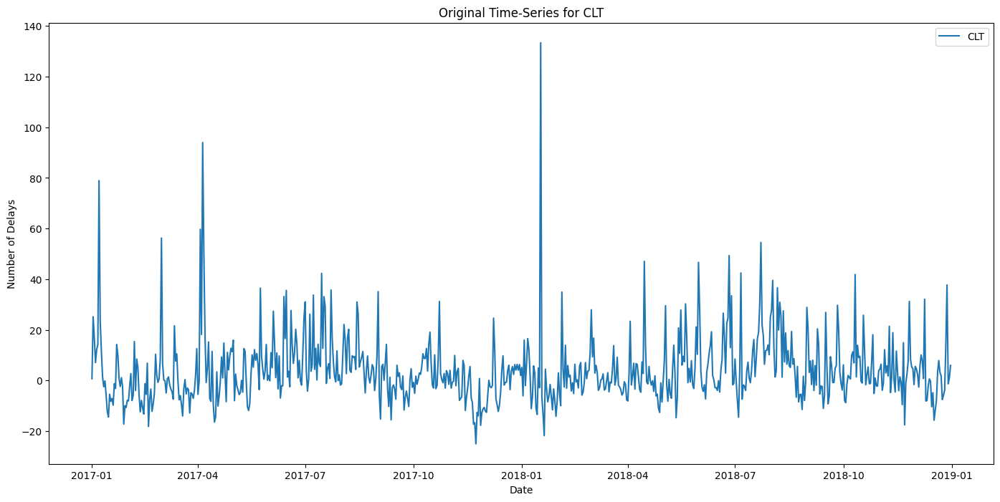

...

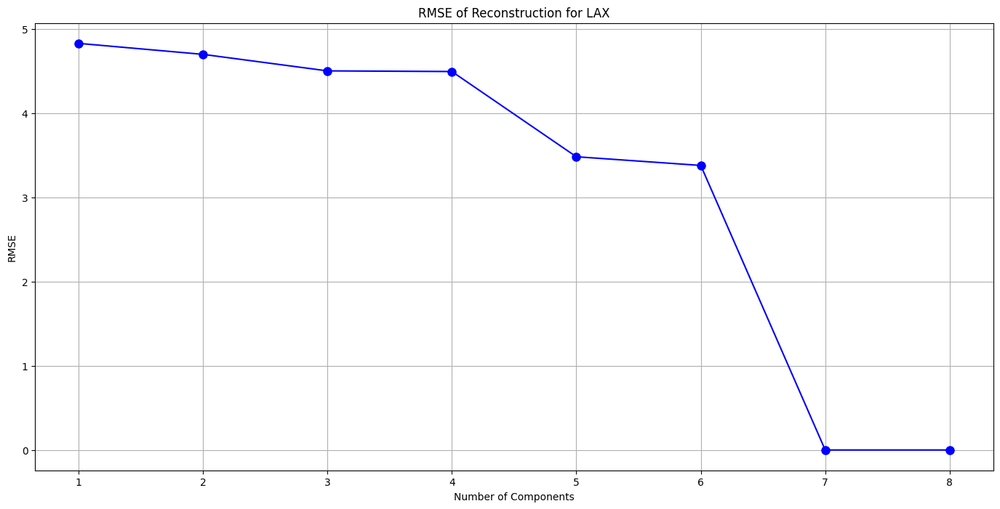

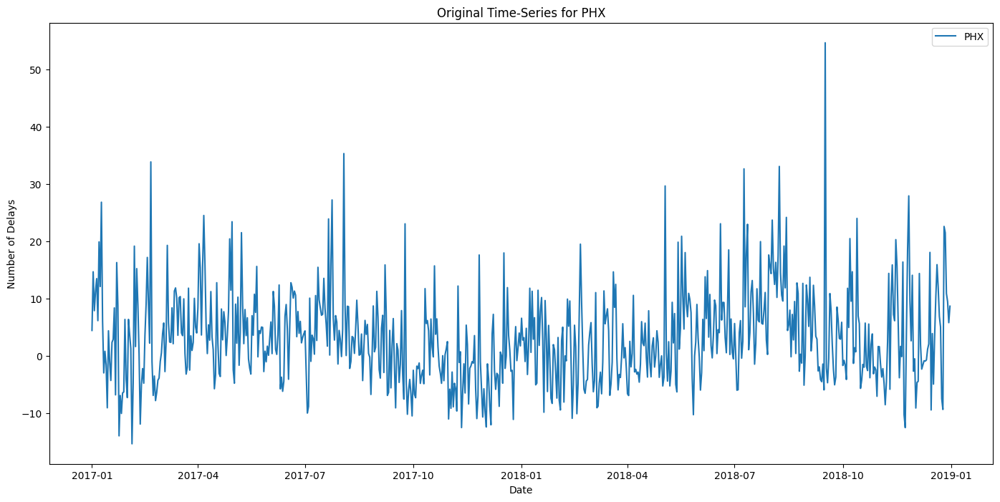

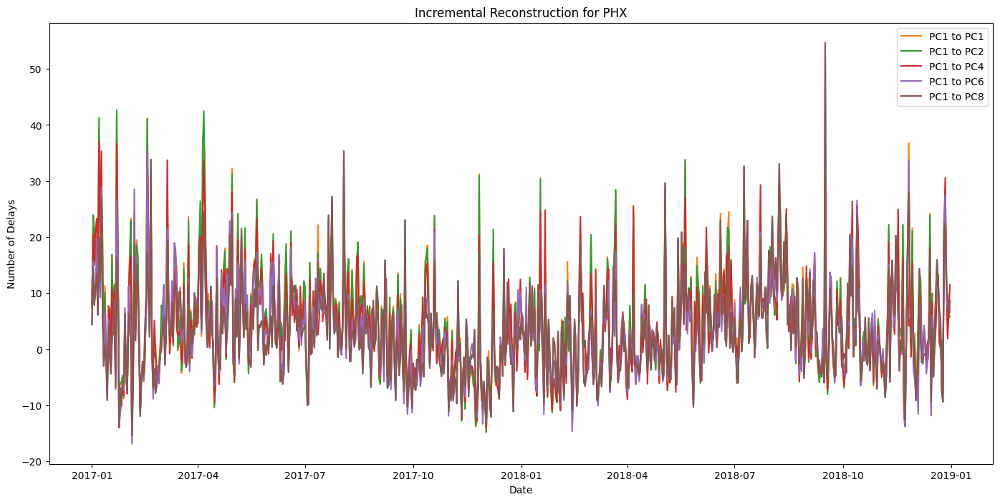

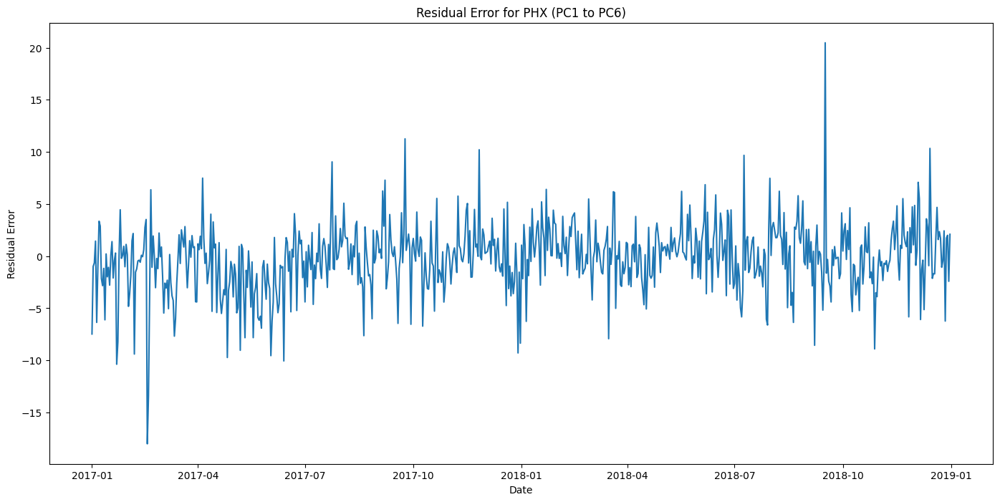

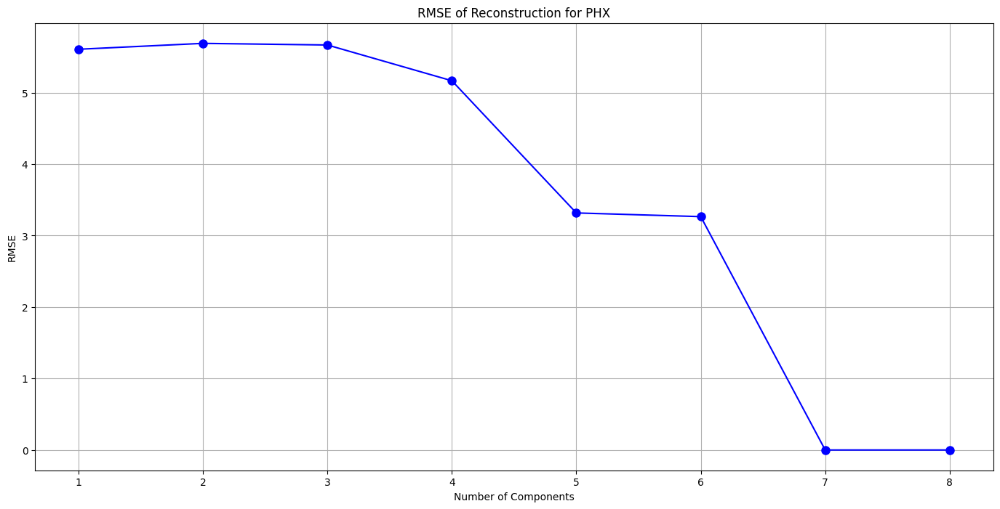

In [32]:
# Part 3

# Load the Excel file
file_path = '/content/AverageDelaysbyOrigin_1.xlsx'
data_raw = pd.read_excel(file_path)

# Ensure the first column is set as the index and the date columns are correctly parsed
data_raw.set_index('Origin', inplace=True)
data_raw.columns = pd.to_datetime(data_raw.columns)

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_raw)

# Define the get_sorted_eigen function
def get_sorted_eigen(cov_matrix):
    eigenValues, eigenVectors = np.linalg.eigh(cov_matrix)
    sorted_indices = np.argsort(eigenValues)[::-1]
    eigenValues = eigenValues[sorted_indices]
    eigenVectors = eigenVectors[:, sorted_indices]
    return eigenValues, eigenVectors

# Step 1: Compute the Covariance Matrix
def compute_covariance_matrix(data):
    return np.cov(data.T)

# Step 2: This function performs the incremental reconstruction and plots the required figures
def plot_reconstruction(state, data_raw):
    data_scaled = scaler.fit_transform(data_raw)
    cov_matrix = compute_covariance_matrix(data_scaled)
    eigenValues, eigenVectors = get_sorted_eigen(cov_matrix)
    expVar = eigenValues / np.sum(eigenValues)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend([state])
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6, 8]
    reconstructions = {}
    for number_of_pcs in pcs_list:
        eigenVectors_subset = eigenVectors[:, :number_of_pcs]
        scores = np.dot(data_scaled, eigenVectors_subset)
        reconstruction_scaled = np.dot(scores, eigenVectors_subset.T)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        reconstructions[number_of_pcs] = reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    for number_of_pcs_1 in pcs_list:
        plt.plot(data_raw.columns, reconstructions[number_of_pcs_1][data_raw.index.get_loc(state)], label=f'PC1 to PC{number_of_pcs_1}')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    best_reconstruction = reconstructions[6]
    residual_error = data_raw.loc[state] - best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, residual_error)
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    rmse = []
    for number_of_pcs_2 in range(1, 9):
        eigenVectors_subset = eigenVectors[:, :number_of_pcs_2]
        scores = np.dot(data_scaled, eigenVectors_subset)
        reconstruction_scaled = np.dot(scores, eigenVectors_subset.T)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        rmse.append(rmse_1)

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 9), rmse, 'o-', markersize=8, color='b')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.grid()
    plt.show()

# Test the function using ATL, CLT, DFW, LAX, and PHX as inputs
for state in ['ATL', 'CLT', 'DFW', 'LAX', 'PHX']:
    plot_reconstruction(state, data_raw)


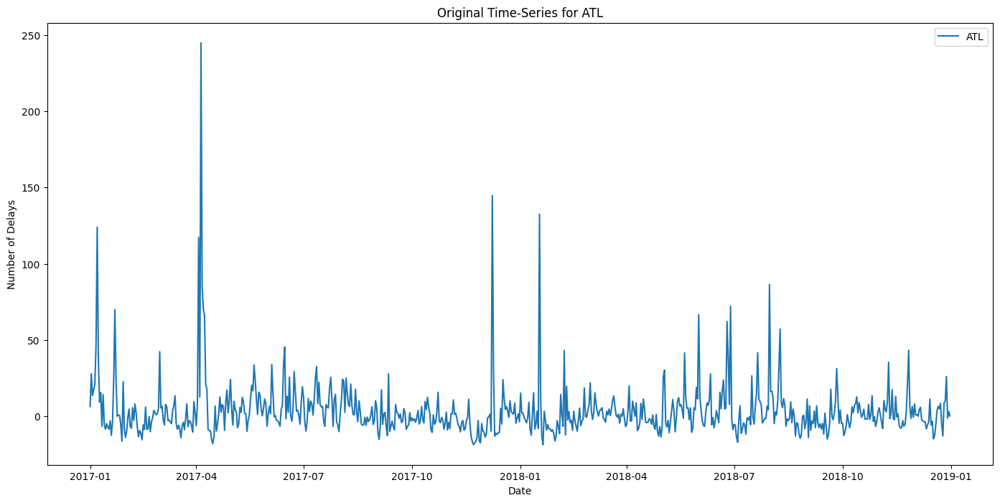

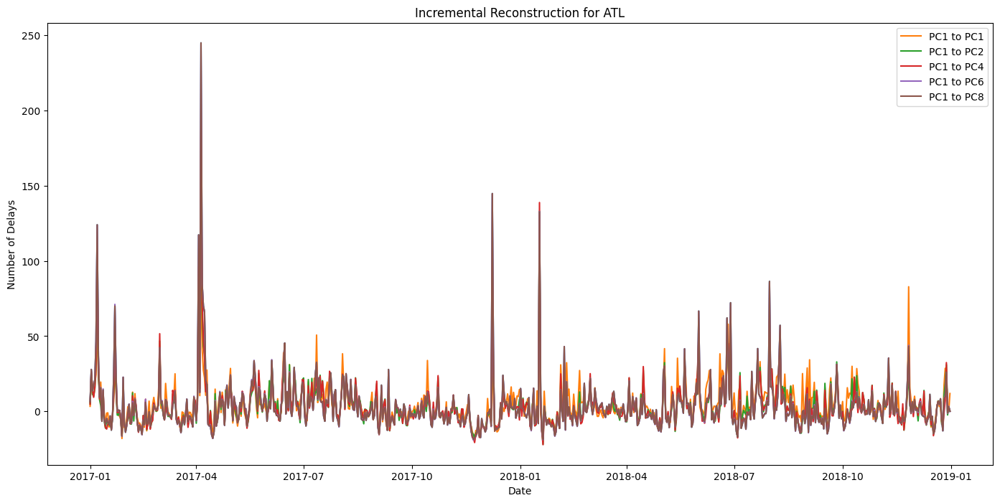

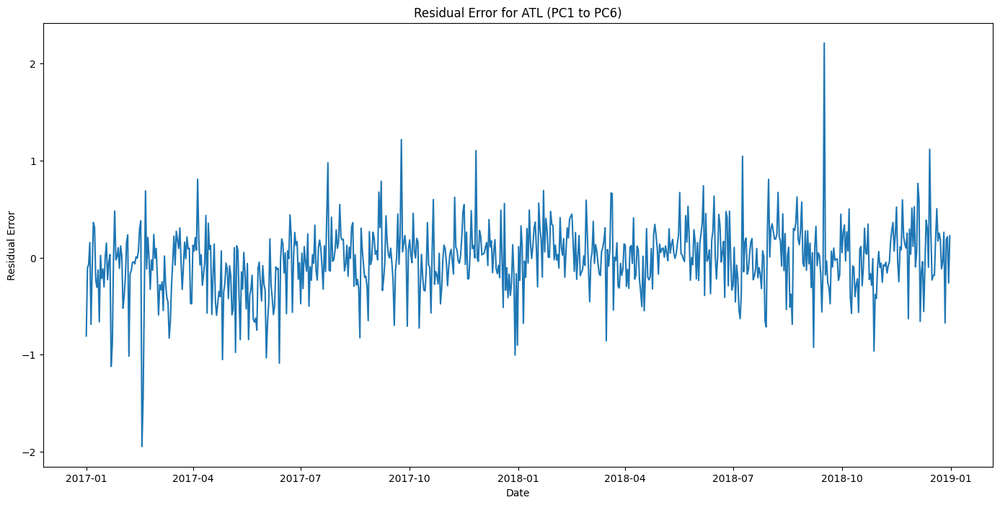

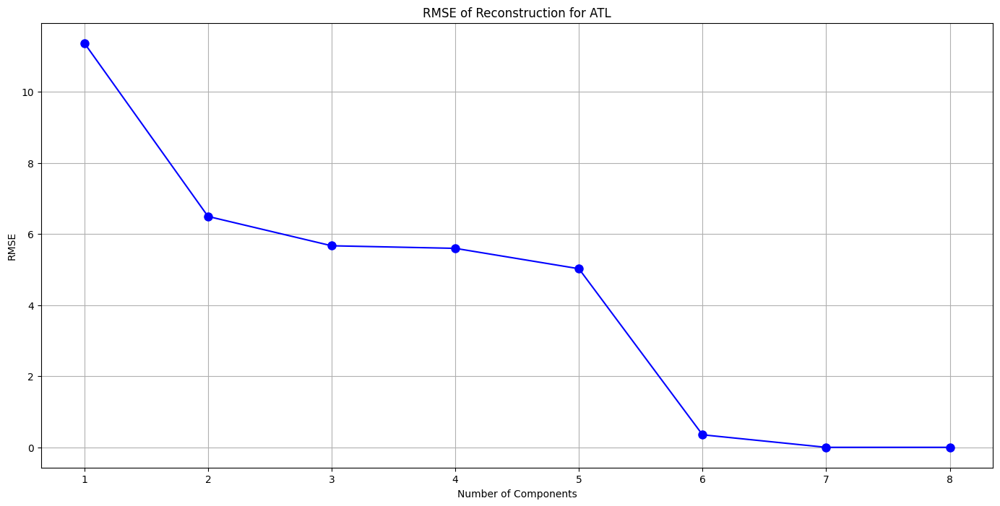

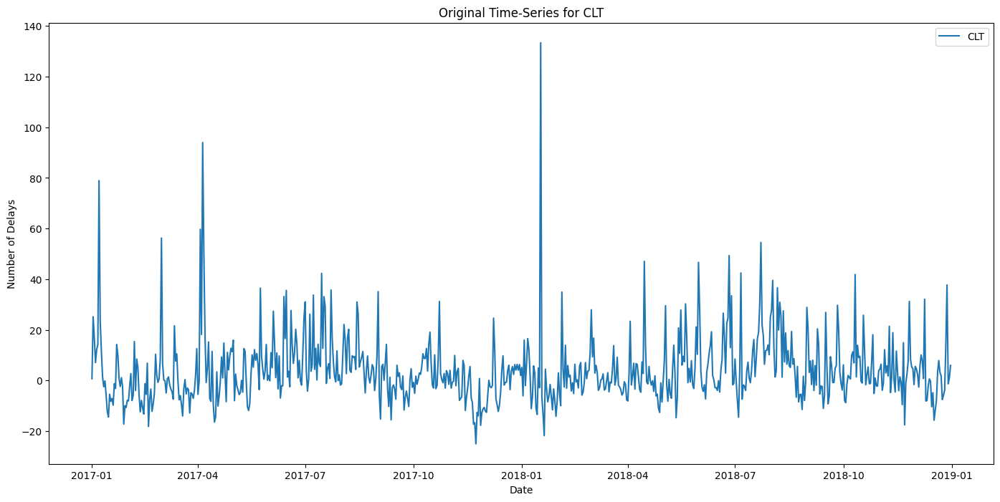

...

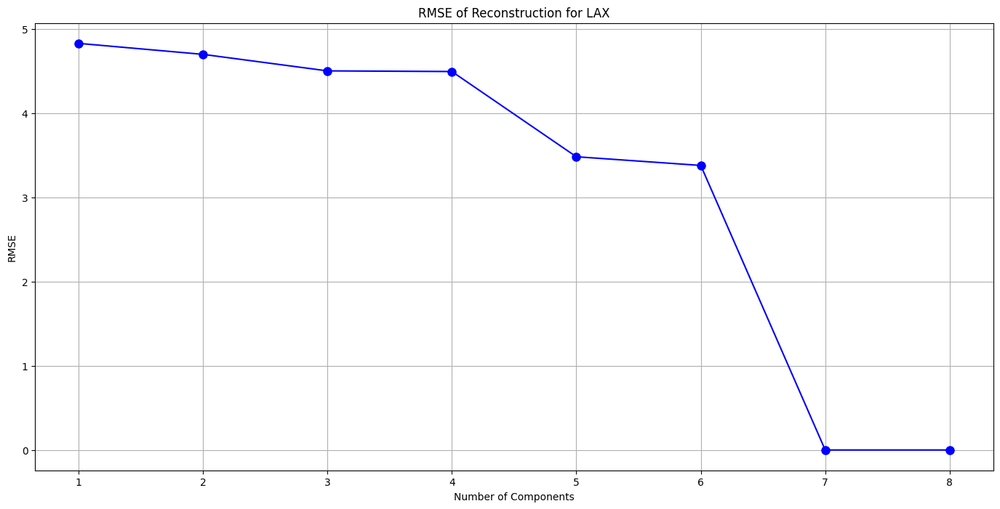

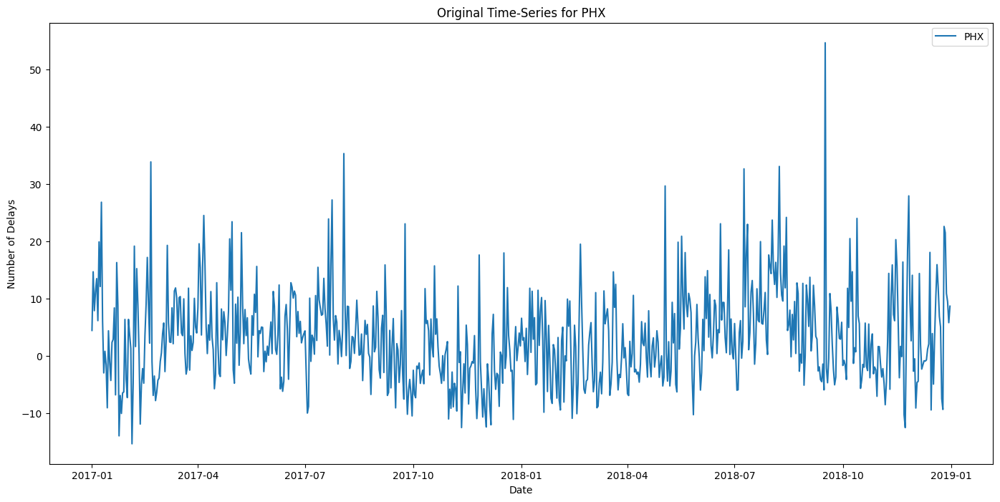

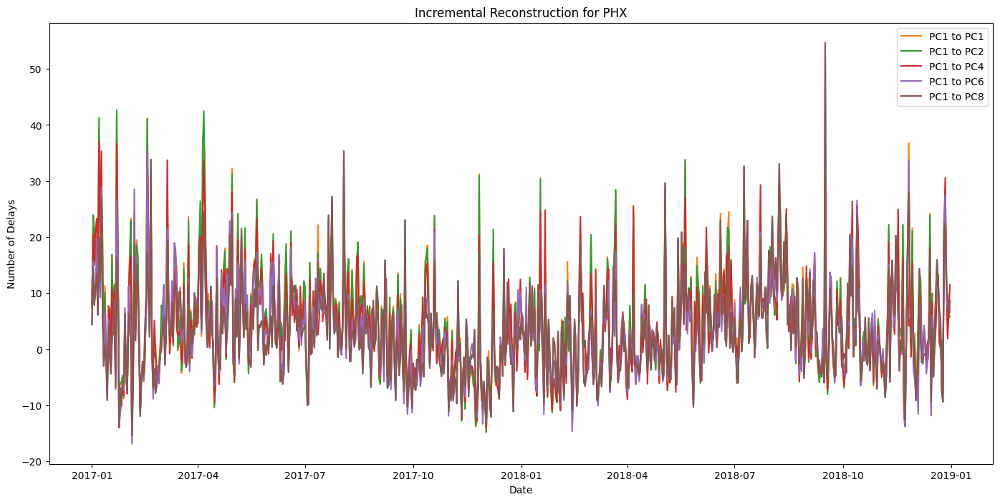

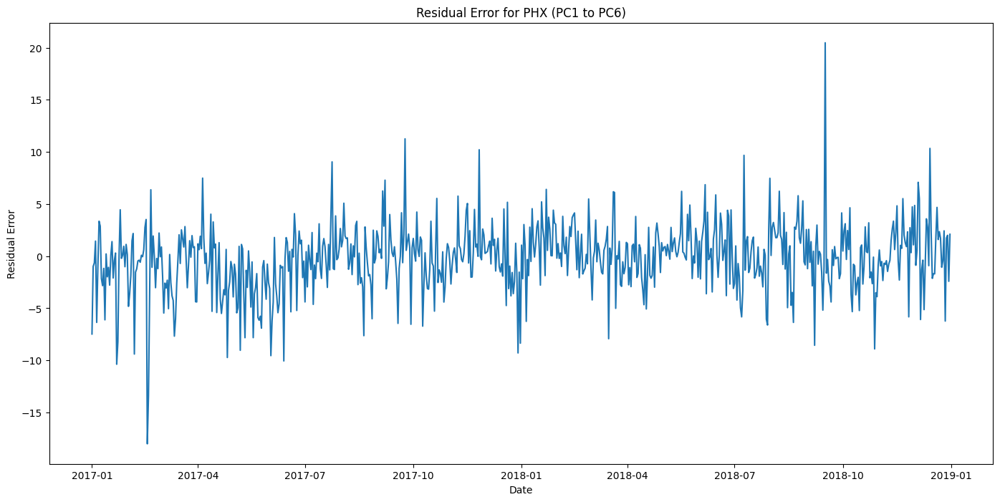

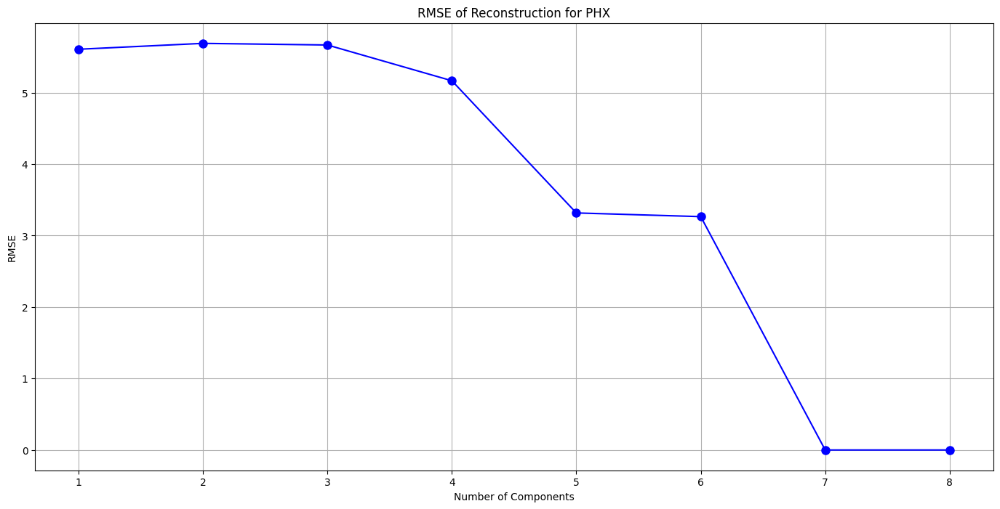

In [33]:
# Part 4

data_raw = pd.read_excel(file_path)

# Ensure the first column is set as the index and the date columns are correctly parsed
data_raw.set_index('Origin', inplace=True)
data_raw.columns = pd.to_datetime(data_raw.columns)

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_raw)

# Step 1: Perform SVD
def perform_svd(data):
    U, S, VT = np.linalg.svd(data, full_matrices=False)
    return U, S, VT

# Step 2: This function performs the incremental reconstruction and plots the required figures
def plot_reconstruction(state, data_raw):
    data_scaled = scaler.fit_transform(data_raw)
    U, S, VT = perform_svd(data_scaled)
    explained_variance = S**2 / np.sum(S**2)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend([state])
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6, 8]
    reconstructions = {}
    for number_of_pcs in pcs_list:
        VT_subset = VT[:number_of_pcs, :]
        scores = np.dot(data_scaled, VT_subset.T)
        reconstruction_scaled = np.dot(scores, VT_subset)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        reconstructions[number_of_pcs] = reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state])
    for number_of_pcs_1 in pcs_list:
        plt.plot(data_raw.columns, reconstructions[number_of_pcs_1][data_raw.index.get_loc(state)], label=f'PC1 to PC{number_of_pcs_1}')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    best_reconstruction = reconstructions[6]
    residual_error = data_raw.loc[state] - best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, residual_error)
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    rmse = []
    for number_of_pcs_2 in range(1, 9):
        VT_subset = VT[:number_of_pcs_2, :]
        scores = np.dot(data_scaled, VT_subset.T)
        reconstruction_scaled = np.dot(scores, VT_subset)
        reconstruction_original = scaler.inverse_transform(reconstruction_scaled)
        rmse_1 = np.sqrt(np.mean((data_raw.loc[state].values - reconstruction_original[data_raw.index.get_loc(state)]) ** 2))
        rmse.append(rmse_1)

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 9), rmse, 'o-', markersize=8, color='b')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.grid()
    plt.show()

# Test the function using ATL, CLT, DFW, LAX, and PHX as inputs
for state in ['ATL', 'CLT', 'DFW', 'LAX', 'PHX']:
    plot_reconstruction(state, data_raw)


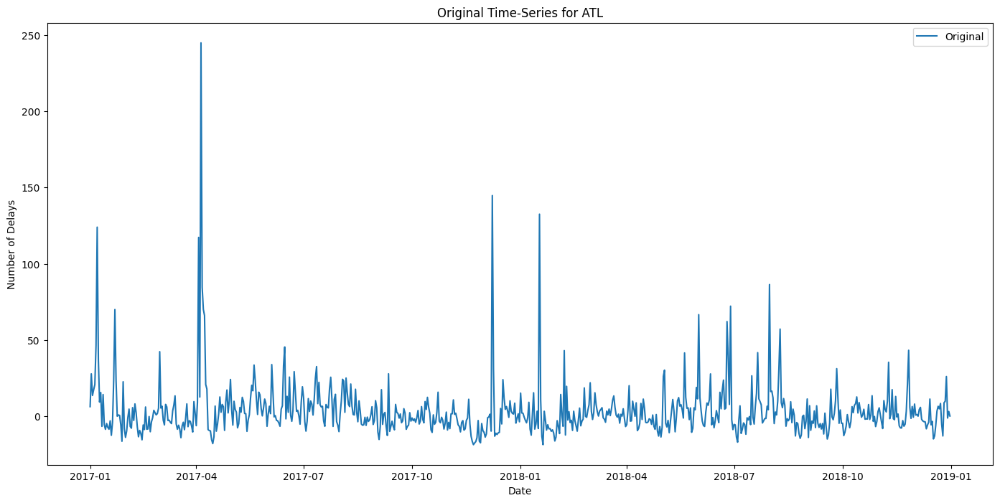

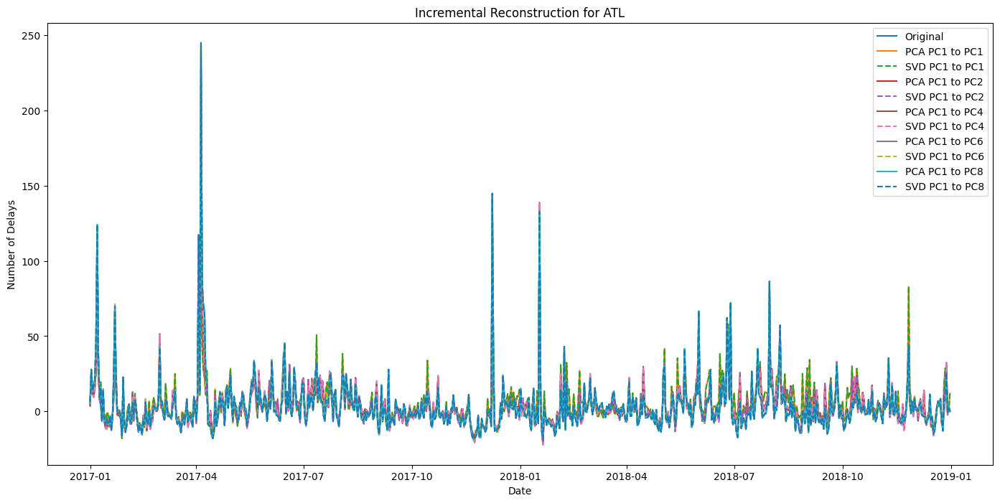

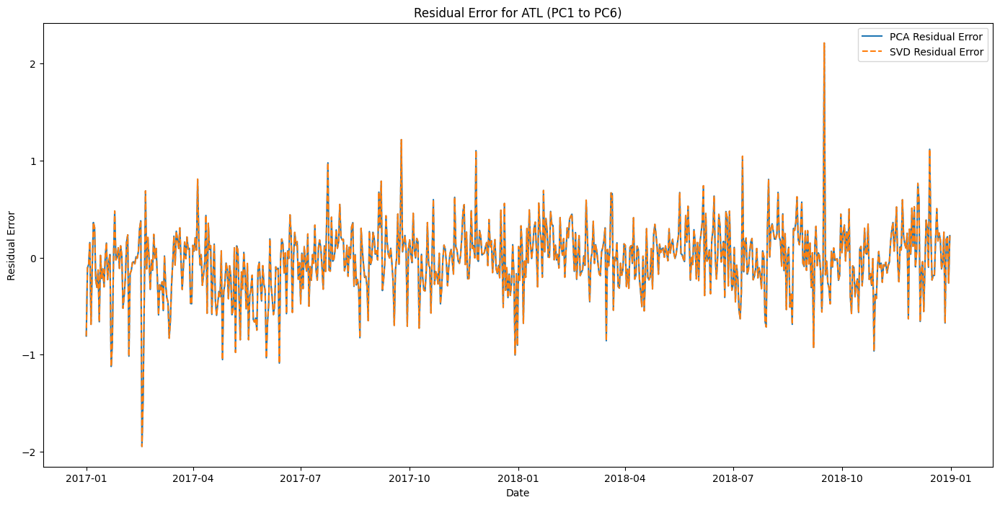

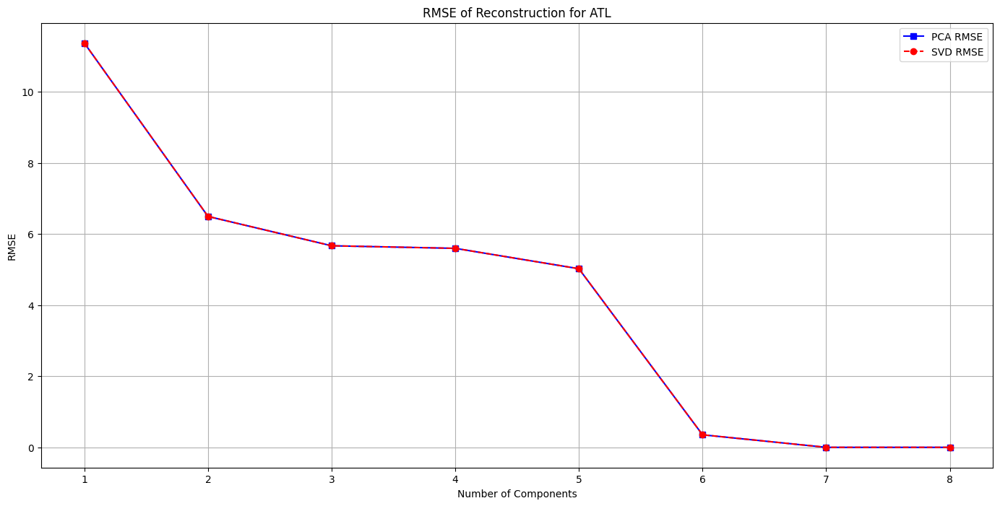

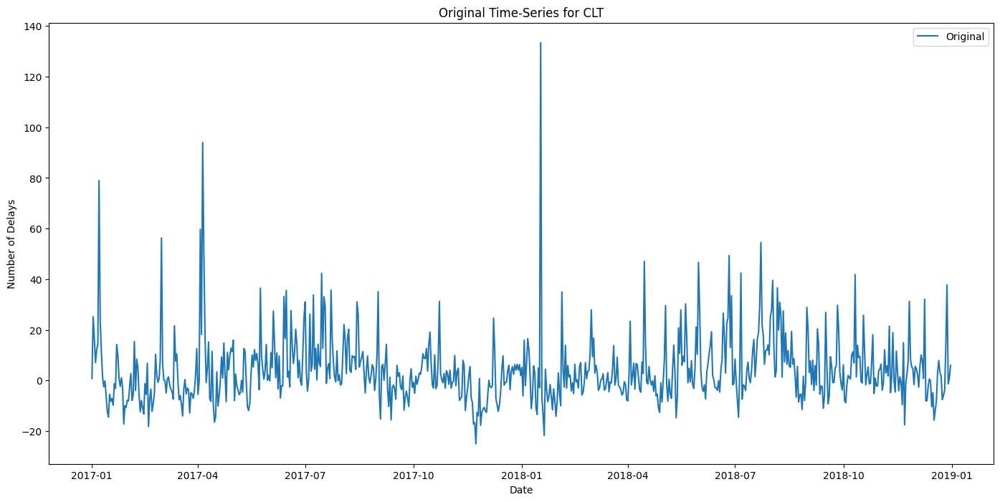

...

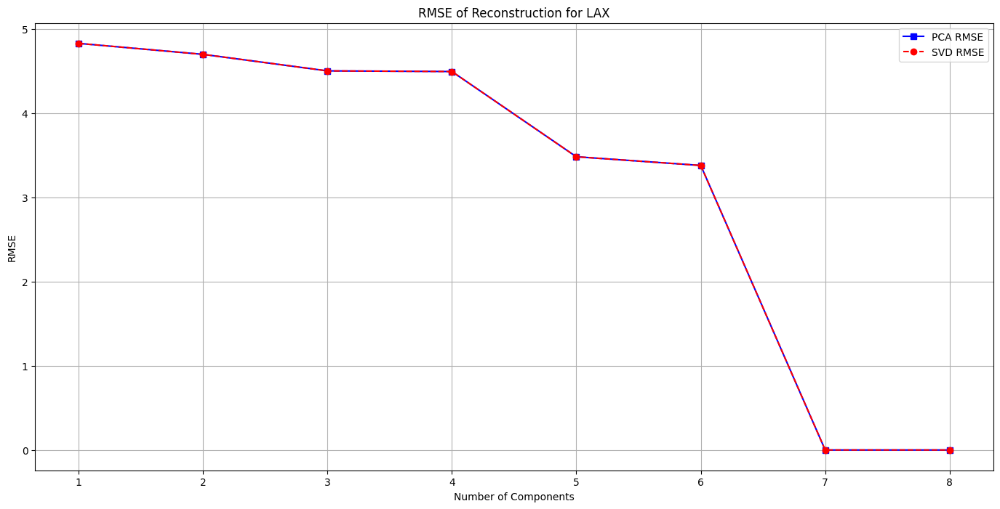

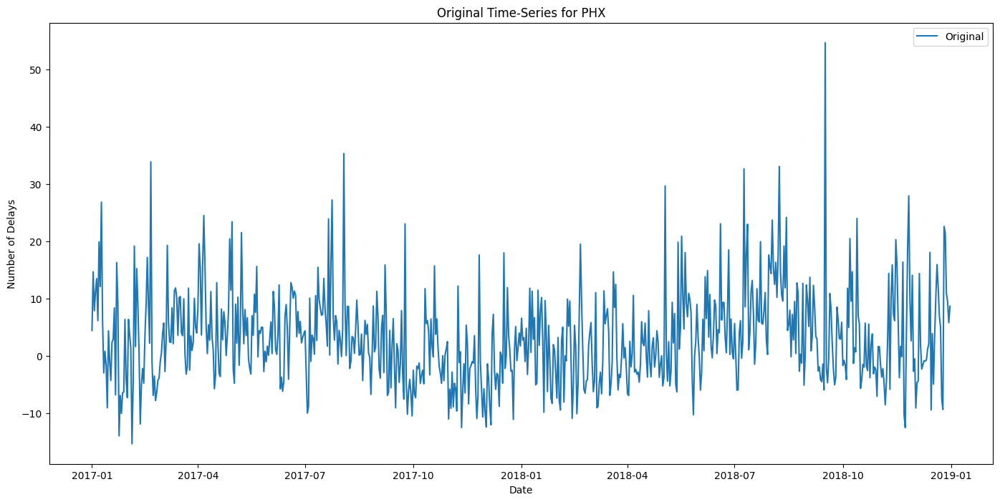

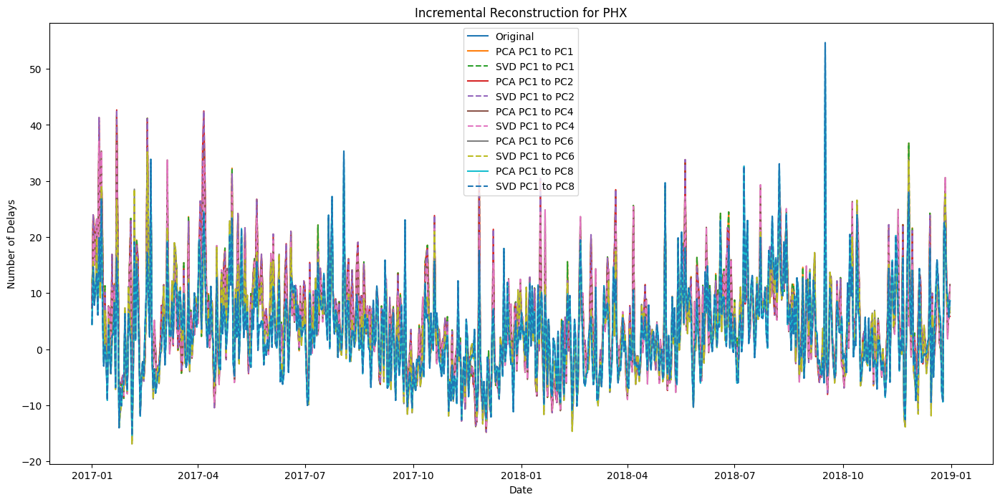

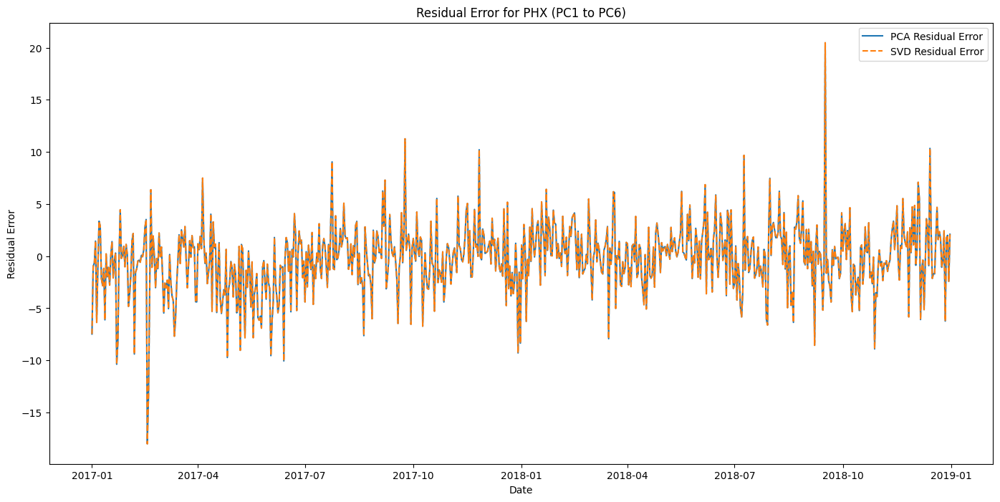

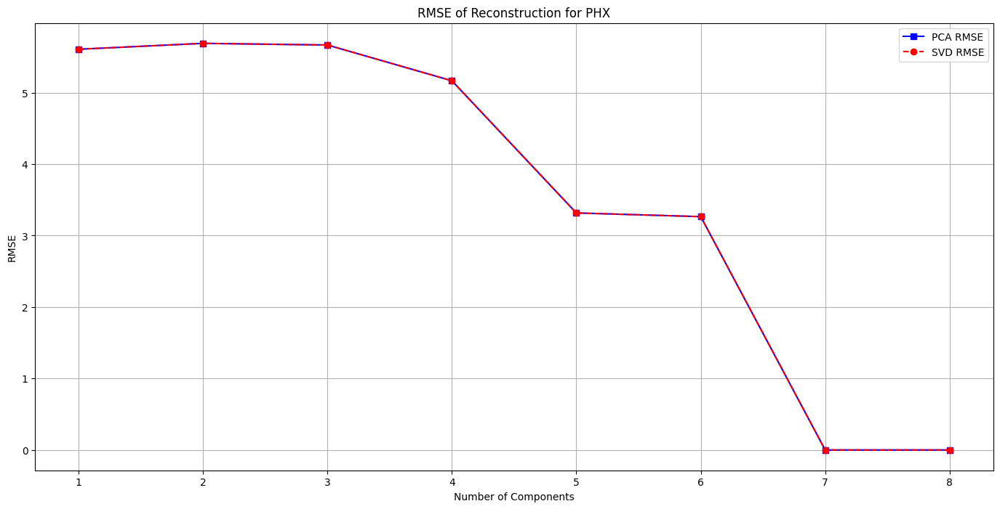

In [34]:
# Comparison between PCA and SVD

data_raw = pd.read_excel(file_path)

# Ensure the first column is set as the index and the date columns are correctly parsed
data_raw.set_index('Origin', inplace=True)
data_raw.columns = pd.to_datetime(data_raw.columns)

# Standardize the data
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_raw)

# Define the get_sorted_eigen function for PCA
def get_sorted_eigen(cov_matrix):
    eigenValues, eigenVectors = np.linalg.eigh(cov_matrix)
    sorted_indices = np.argsort(eigenValues)[::-1]
    return eigenValues[sorted_indices], eigenVectors[:, sorted_indices]

# Perform SVD
def perform_svd(data):
    U, S, VT = np.linalg.svd(data, full_matrices=False)
    return U, S, VT

# Compute the Covariance Matrix
def compute_covariance_matrix(data):
    return np.cov(data.T)

# Function to plot the comparison between PCA and SVD
def plot_comparison(state, data_raw):
    data_scaled = scaler.fit_transform(data_raw)
    cov_matrix = compute_covariance_matrix(data_scaled)

    # PCA
    pca_eigenValues, pca_eigenVectors = get_sorted_eigen(cov_matrix)
    pca_expVar = pca_eigenValues / np.sum(pca_eigenValues)

    # SVD
    U, S, VT = perform_svd(data_scaled)
    svd_expVar = S**2 / np.sum(S**2)

    # Figure 1: Original time-series plot
    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state], label='Original')
    plt.title(f'Original Time-Series for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 2: Incremental reconstruction
    pcs_list = [1, 2, 4, 6, 8]
    pca_reconstructions = {}
    svd_reconstructions = {}

    for number_of_pcs in pcs_list:
        pca_eigenVectors_subset = pca_eigenVectors[:, :number_of_pcs]
        pca_scores = np.dot(data_scaled, pca_eigenVectors_subset)
        pca_reconstruction_scaled = np.dot(pca_scores, pca_eigenVectors_subset.T)
        pca_reconstruction_original = scaler.inverse_transform(pca_reconstruction_scaled)
        pca_reconstructions[number_of_pcs] = pca_reconstruction_original

        svd_VT_subset = VT[:number_of_pcs, :]
        svd_scores = np.dot(data_scaled, svd_VT_subset.T)
        svd_reconstruction_scaled = np.dot(svd_scores, svd_VT_subset)
        svd_reconstruction_original = scaler.inverse_transform(svd_reconstruction_scaled)
        svd_reconstructions[number_of_pcs] = svd_reconstruction_original

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, data_raw.loc[state], label='Original')
    for number_of_pcs in pcs_list:
        plt.plot(data_raw.columns, pca_reconstructions[number_of_pcs][data_raw.index.get_loc(state)],
                 label=f'PCA PC1 to PC{number_of_pcs}')
        plt.plot(data_raw.columns, svd_reconstructions[number_of_pcs][data_raw.index.get_loc(state)],
                 linestyle='dashed', label=f'SVD PC1 to PC{number_of_pcs}')
    plt.title(f'Incremental Reconstruction for {state}')
    plt.xlabel('Date')
    plt.ylabel('Number of Delays')
    plt.legend()
    plt.show()

    # Figure 3: Residual error plot for best reconstruction (PC1 to PC6)
    pca_best_reconstruction = pca_reconstructions[6]
    pca_residual_error = data_raw.loc[state] - pca_best_reconstruction[data_raw.index.get_loc(state)]

    svd_best_reconstruction = svd_reconstructions[6]
    svd_residual_error = data_raw.loc[state] - svd_best_reconstruction[data_raw.index.get_loc(state)]

    plt.figure(figsize=(17, 8))
    plt.plot(data_raw.columns, pca_residual_error, label='PCA Residual Error')
    plt.plot(data_raw.columns, svd_residual_error, linestyle='dashed', label='SVD Residual Error')
    plt.title(f'Residual Error for {state} (PC1 to PC6)')
    plt.xlabel('Date')
    plt.ylabel('Residual Error')
    plt.legend()
    plt.show()

    # Figure 4: RMSE plot for reconstruction as a function of number of components
    pca_rmse = []
    svd_rmse = []
    for number_of_pcs in range(1, 9):
        pca_eigenVectors_subset = pca_eigenVectors[:, :number_of_pcs]
        pca_scores = np.dot(data_scaled, pca_eigenVectors_subset)
        pca_reconstruction_scaled = np.dot(pca_scores, pca_eigenVectors_subset.T)
        pca_reconstruction_original = scaler.inverse_transform(pca_reconstruction_scaled)
        pca_rmse.append(np.sqrt(np.mean((data_raw.loc[state].values - pca_reconstruction_original[data_raw.index.get_loc(state)]) ** 2)))

        svd_VT_subset = VT[:number_of_pcs, :]
        svd_scores = np.dot(data_scaled, svd_VT_subset.T)
        svd_reconstruction_scaled = np.dot(svd_scores, svd_VT_subset)
        svd_reconstruction_original = scaler.inverse_transform(svd_reconstruction_scaled)
        svd_rmse.append(np.sqrt(np.mean((data_raw.loc[state].values - svd_reconstruction_original[data_raw.index.get_loc(state)]) ** 2)))

    plt.figure(figsize=(17, 8))
    plt.plot(range(1, 9), pca_rmse, 's-', color='b', label='PCA RMSE')
    plt.plot(range(1, 9), svd_rmse, 'o--', color='r', label='SVD RMSE')
    plt.title(f'RMSE of Reconstruction for {state}')
    plt.xlabel('Number of Components')
    plt.ylabel('RMSE')
    plt.legend()
    plt.grid()
    plt.show()

# Test the function using ATL, CLT, DFW, LAX, and PHX as inputs
for state in ['ATL', 'CLT', 'DFW', 'LAX', 'PHX']:
    plot_comparison(state, data_raw)


**How many features does the final dataset have? How many cities (ORIGIN airport codes) are there?**

There are 730 features in the final dataset. Also, there are 8 cities.

**Comment on the results.**

The RMSE results for the affects cities are the same for PCA and SVD. However, the residual error and incremental reconstruction were different. These results are very similar to part 3 and part 4. Lots of delays have occured during the winter and new year season.

# References

Understanding PCA and SVD:

1. https://towardsdatascience.com/pca-and-svd-explained-with-numpy-5d13b0d2a4d8

2. https://stats.stackexchange.com/questions/134282/relationship-between-svd-and-pca-how-to-use-svd-to-perform-pca

3. https://stats.stackexchange.com/questions/2691/making-sense-of-principal-component-analysis-eigenvectors-eigenvalues

4. https://hadrienj.github.io/posts/Deep-Learning-Book-Series-2.8-Singular-Value-Decomposition/

PCA:

1. Snippets from: https://plot.ly/ipython-notebooks/principal-component-analysis/

2. https://www.value-at-risk.net/principal-component-analysis/

Flight Delays Data:

1. https://www.kaggle.com/datasets/gabrielluizone/us-domestic-flights-delay-prediction-2013-2018